## AIM: Train multiclass classification ML models for predicting the psychiatric diagnosis based on EEG features

SVC, RanFor & GradientBoostingClassifier for predicting psychiatric diagnosis with statistical features of the power per frequency band per channel group. Statistical features are calculated with EC data, EO data and a with the ratio between EC divided by EO. Compared to older versions of this notebook (found in 'old_notebooks' dir); gender will not be used as a feature, the data will be subsampled by diagnosis to rebalance the dataset, only Boruta selected features will be used, no PCA, and additional models including the functional connectivity features will be trained.

see 'paired_t_test_ml_models.ipynb' in 'background_notebooks' for paired t-tests of the F1-scores between the models

In [1]:
import numpy as np
import pandas as pd
import sklearn
import pickle
import joblib
import mne
import os
import matplotlib.pyplot as plt
from mne.time_frequency import tfr_multitaper

%matplotlib inline

# prevent extensive logging
mne.set_log_level('WARNING')

## Loading in feature data

#### Boruta-selected stat features

In [2]:
df_stat_features = pd.read_pickle('df_selected_stat_features.pkl')
df_stat_features = df_stat_features.dropna(subset=['diagnosis'])
df_stat_features.sample(7)

,ID,epoch,diagnosis,EC_l_frontal_delta_mean,EC_l_frontal_delta_median,EC_l_frontal_theta_std,EC_l_frontal_theta_mean,EC_l_frontal_theta_median,EC_l_frontal_alpha_std,EC_l_frontal_alpha_mean,...,ratio_r_posterior_delta_median,ratio_r_posterior_theta_mean,ratio_r_posterior_theta_median,ratio_r_posterior_alpha_median,ratio_r_posterior_beta_std,ratio_r_posterior_beta_mean,ratio_r_posterior_beta_median,ratio_r_posterior_gamma_std,ratio_r_posterior_gamma_mean,ratio_r_posterior_gamma_median
3828,sub-88040317,1,ADHD,0.107443,0.107443,0.037968,0.056597,0.056597,0.025979,0.036261,...,0.993017,1.446238,1.161476,1.751886,1.772685,2.269817,1.842223,2.846892,2.717258,1.696068
2769,sub-88025917,10,ADHD,0.086056,0.086056,0.040535,0.060506,0.060506,0.051722,0.048507,...,0.795112,1.113219,0.679794,1.520211,3.405737,2.403883,1.429349,0.641400,1.260414,1.182218
1019,sub-87971373,12,SMC,0.045136,0.045136,0.021930,0.034274,0.034274,0.048418,0.089543,...,1.067702,1.538495,0.987006,2.408342,3.158001,3.145676,2.217332,0.421366,0.839517,0.764346
3461,sub-88035229,6,MDD,0.103160,0.103160,0.037117,0.068129,0.068129,0.013403,0.031095,...,1.167948,1.290925,1.009707,1.091481,0.589888,1.204502,1.080783,1.446354,1.618981,1.175129
2665,sub-88025281,2,MDD,0.084041,0.084041,0.028893,0.046995,0.046995,0.015912,0.033938,...,0.925108,2.019633,1.292495,1.575089,1.160383,1.581532,1.302355,1.097127,2.020597,1.950870
7732,sub-88076181,5,OCD,0.101073,0.101073,0.030344,0.051520,0.051520,0.030292,0.042891,...,0.819872,1.297543,0.988038,2.655443,4.518594,2.558772,1.591595,1.625673,1.519442,1.015477
640,sub-87968901,5,SMC,0.032989,0.032989,0.041072,0.062783,0.062783,0.046696,0.069916,...,0.477917,2.519292,1.899703,1.862549,0.702629,0.942144,0.756685,0.240392,0.474493,0.444141


In [3]:
df_stat_features['diagnosis'].value_counts()

diagnosis
SMC        540
HEALTHY    540
MDD        540
ADHD       540
OCD        540
Name: count, dtype: int64

In [4]:
# create 3 feature sets [EC, EO, ratio] with column ['ID', 'age', 'gender', 'diagnosis', 'epoch']
df_stat_features_ec = df_stat_features[df_stat_features.columns[~(df_stat_features.columns.str.startswith('EO') | df_stat_features.columns.str.startswith('ratio'))]]
df_stat_features_eo = df_stat_features[df_stat_features.columns[~(df_stat_features.columns.str.startswith('EC') | df_stat_features.columns.str.startswith('ratio'))]]
df_stat_features_ratio = df_stat_features[df_stat_features.columns[~(df_stat_features.columns.str.startswith('EC') | df_stat_features.columns.str.startswith('EO'))]]

#### Boruta-selected stat features + connectivity features

In [5]:
df_stat_conn_features = pd.read_pickle('df_selected_stat_conn_features.pkl')
df_stat_conn_features = df_stat_conn_features.dropna(subset=['diagnosis'])
df_stat_conn_features.sample(7)

,ID,epoch,diagnosis,EC_l_frontal_delta_std,EC_l_frontal_delta_mean,EC_l_frontal_delta_median,EC_l_frontal_theta_std,EC_l_frontal_theta_mean,EC_l_frontal_theta_median,EC_l_frontal_alpha_std,...,ratio_gamma_m_central-r_central,ratio_gamma_m_central-l_posterior,ratio_gamma_m_central-m_posterior,ratio_gamma_m_central-r_posterior,ratio_gamma_r_central-l_posterior,ratio_gamma_r_central-m_posterior,ratio_gamma_r_central-r_posterior,ratio_gamma_l_posterior-m_posterior,ratio_gamma_l_posterior-r_posterior,ratio_gamma_m_posterior-r_posterior
1034,sub-88020017,3,MDD,0.068623,0.084077,0.084077,0.030246,0.068736,0.068736,0.028575,...,0.945749,1.046770,0.992981,0.989280,1.013831,0.975895,0.983482,0.995027,1.014589,0.989186
1095,sub-88023213,4,ADHD,0.034947,0.056142,0.056142,0.033697,0.065227,0.065227,0.046232,...,0.986429,0.979326,0.977567,0.969828,0.997615,0.979710,0.985701,0.989453,0.995865,0.968822
354,sub-87969665,7,SMC,0.016832,0.023381,0.023381,0.033988,0.056718,0.056718,0.055725,...,1.004795,1.023126,1.011056,1.003642,1.029576,1.016970,1.005286,1.017691,1.020949,1.007539
2556,sub-88073521,1,ADHD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2283,sub-88065153,4,OCD,0.034140,0.051641,0.051641,0.043682,0.058069,0.058069,0.064955,...,1.003170,1.028168,1.017996,1.006894,1.056779,1.045110,1.020748,1.006694,1.012730,1.004811
1623,sub-88048549,4,OCD,0.086718,0.084112,0.084112,0.036375,0.050937,0.050937,0.031358,...,0.962541,0.983581,0.991070,0.986966,0.978092,0.987063,1.005350,1.011387,0.979206,0.997505
2688,sub-88076717,1,OCD,0.063600,0.072059,0.072059,0.035979,0.058535,0.058535,0.050674,...,1.013695,1.041675,1.054096,1.032691,1.068668,1.068559,1.036403,1.022094,1.061229,1.032661


In [6]:
df_stat_conn_features['diagnosis'].value_counts()

diagnosis
SMC        540
HEALTHY    540
MDD        540
ADHD       540
OCD        540
Name: count, dtype: int64

In [7]:
# create 3 feature sets [EC, EO, ratio] with column ['ID', 'age', 'gender', 'diagnosis', 'epoch']
df_stat_conn_features_ec = df_stat_conn_features[df_stat_conn_features.columns[~(df_stat_conn_features.columns.str.startswith('EO') | df_stat_conn_features.columns.str.startswith('ratio'))]]
df_stat_conn_features_eo = df_stat_conn_features[df_stat_conn_features.columns[~(df_stat_conn_features.columns.str.startswith('EC') | df_stat_conn_features.columns.str.startswith('ratio'))]]
df_stat_conn_features_ratio = df_stat_conn_features[df_stat_conn_features.columns[~(df_stat_conn_features.columns.str.startswith('EC') | df_stat_conn_features.columns.str.startswith('EO'))]]

In [8]:
print(df_stat_conn_features_ratio.shape)
print(df_stat_conn_features_ec.shape)
print(df_stat_conn_features_eo.shape)

(2700, 185)
(2700, 322)
(2700, 304)


In [9]:
df_stat_conn_features_ec.isna().sum()

ID                                   0
epoch                                0
diagnosis                            0
EC_l_frontal_delta_std              12
EC_l_frontal_delta_mean             12
                                    ..
EC_gamma_r_central-m_posterior      12
EC_gamma_r_central-r_posterior      12
EC_gamma_l_posterior-m_posterior    12
EC_gamma_l_posterior-r_posterior    12
EC_gamma_m_posterior-r_posterior    12
Length: 322, dtype: int64

In [10]:
# obtain indices for the first outer split for the ML models, to use as validation set for the GCNs for model comparison (which is the same as long as shuffle=False)
from sklearn.model_selection import StratifiedGroupKFold
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False)
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False)

split_indices = {}
for df_feature_set, feature_set in zip([df_stat_conn_features_ratio, df_stat_conn_features_ec, df_stat_conn_features_eo], ['ratio', 'EC', 'EO']):
    numeric_cols = [num_col for num_col in df_feature_set.columns if feature_set in num_col]
    df_feature_set = df_feature_set.dropna(subset=numeric_cols)
    groups = df_feature_set['ID'].tolist()
    X = df_feature_set[numeric_cols]
    Y = df_feature_set['diagnosis']
    # split test set from data
    baseline_rest_idxs, baseline_test_idxs = cv_outer.split(X, Y, groups).__next__()
    X_rest, Y_rest = X.iloc[baseline_rest_idxs], Y.iloc[baseline_rest_idxs]
    groups_array = np.array(groups)
    groups_rest = groups_array[baseline_rest_idxs]

    # split train and val set
    baseline_train_idxs, baseline_val_idxs = cv_inner.split(X_rest, Y_rest, groups_rest).__next__()
    groups_test = groups_array[baseline_test_idxs]
    groups_train = groups_rest[baseline_train_idxs]
    groups_val = groups_rest[baseline_val_idxs]
    unique_groups_test = np.unique(groups_test)
    unique_groups_train = np.unique(groups_train)
    unique_groups_val = np.unique(groups_val)

    split_indices[feature_set] = (unique_groups_train, unique_groups_val, unique_groups_test)
    

# save the split indices for GCN model comparison
with open('data_split_groups.pkl', 'wb') as f:
    pickle.dump(split_indices, f)

# Training models (SVC, RF, GBC):
Each model is tuned & trained seperately with the selected ratio, EC, EO features from the two feature sets: 1) statistical TFR feature (baseline), 2) statistical TFR + connectivity features (extended). All models are tuned, trained & evaluated using nested cv (inner=3, outer=5), with SVC using GridSearchCV for tuning, and RF & GBC using RandomizedSearchCV for tuning.

# 1. statistical TFR features (baseline):

## SVC

#### ratio feature set

In [11]:
from sklearn import svm
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.svm import SVC
from sklearn.multiclass import OneVsRestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_features_ratio['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_features_ratio.columns if 'ratio' in num_col]
 
X = df_stat_features_ratio[numeric_cols]
Y = df_stat_features_ratio['diagnosis']
# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols),
    ],
    remainder='drop',
    n_jobs=-1)

# hyperparameter ranges for GridSearch
param_grid = {
'rbf_svm__estimator__C': [0.01, 0.1, 1, 10, 100],
'rbf_svm__estimator__gamma': [0.1, 1, 10, 100],
'rbf_svm__estimator__kernel': ['rbf'],
'rbf_svm__estimator__class_weight': ['balanced']
}

# final pipeline
steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(class_weight = 'balanced')))]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

# define gridsearch
gridsearch = GridSearchCV(pipeline,
                        param_grid = param_grid,
                        cv = cv_inner, # use inner cv for hyperparameter tuning
                        scoring = f1_scorer,
                        error_score = 'raise',
                        return_train_score = True,
                        n_jobs=-1,
                        verbose=1)

# nested CV with parameter optimization to compute testing score (f1-score)
nested_cv_gridsearch = cross_validate(gridsearch,
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 return_estimator=True,
                                 return_train_score = False,
                                 verbose=1,
                                 n_jobs=-1)
print('SVM test scores:', nested_cv_gridsearch['test_score'])
print('Mean SVM test score:', np.mean(nested_cv_gridsearch['test_score']))
print('STD SVM test score:', np.std(nested_cv_gridsearch['test_score']))

# obtain best model during nested CV
best_score_index = np.argmax(nested_cv_gridsearch['test_score'])
best_model = nested_cv_gridsearch['estimator'][best_score_index]
print('Parameters of the best model:', best_model.best_params_)


# of instances: 2700
(2700, 5)


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

SVM test scores: [0.26175223 0.23213146 0.22483193 0.20023039 0.24957504]
Mean SVM test score: 0.23370421363900512
STD SVM test score: 0.021167248631063763
Parameters of the best model: {'rbf_svm__estimator__C': 10, 'rbf_svm__estimator__class_weight': 'balanced', 'rbf_svm__estimator__gamma': 0.1, 'rbf_svm__estimator__kernel': 'rbf'}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   27.9s finished


In [12]:
# save the nested CV
joblib.dump(nested_cv_gridsearch, 'nested_cv_stat_svm_ratio.pkl', compress=3)

['nested_cv_stat_svm_ratio.pkl']

{'C': 10, 'class_weight': 'balanced', 'gamma': 0.1, 'kernel': 'rbf'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    9.2s finished


f1_score: 0.23101347166153488

classification report:
               precision    recall  f1-score   support

        ADHD       0.30      0.32      0.31       540
     HEALTHY       0.22      0.20      0.21       540
         MDD       0.20      0.19      0.19       540
         OCD       0.22      0.19      0.21       540
         SMC       0.21      0.26      0.23       540

    accuracy                           0.23      2700
   macro avg       0.23      0.23      0.23      2700
weighted avg       0.23      0.23      0.23      2700



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    9.1s finished


Micro-averaged One-vs-Rest ROC AUC score:
0.54


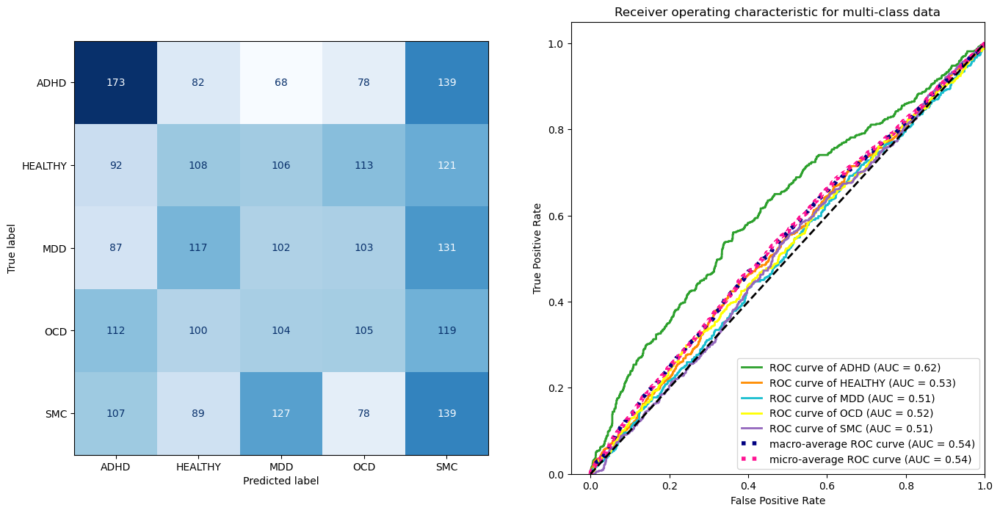

In [13]:
# final evaluation on best tuned model pipeline
best_params = {}
for hyperparameter in best_model.best_params_: # get the best hyperparameters from nested CV
    key = hyperparameter[20:]
    best_params[key] = best_model.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(**best_params, probability=True)))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

from sklearn.metrics import roc_auc_score

micro_roc_auc_ovr = roc_auc_score(
    Y_one_hot,
    Y_score,
    multi_class="ovr",
    average="micro",
)

print(f"Micro-averaged One-vs-Rest ROC AUC score:\n{micro_roc_auc_ovr:.2f}")

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

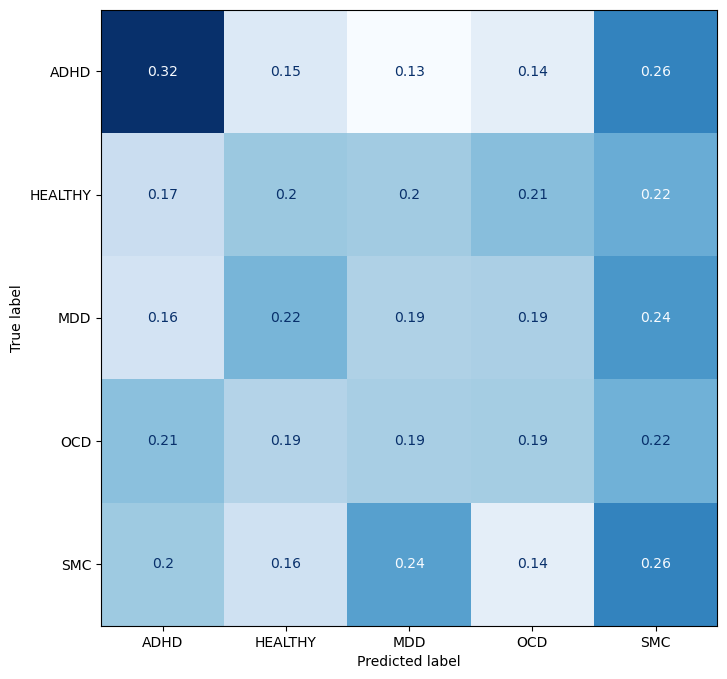

In [14]:
# print the confusion matrix normalized by true labels
fig, ax = plt.subplots(figsize=(8,8))
conf_matrix = confusion_matrix(Y, Y_pred, normalize='true')
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', colorbar=False, ax=ax)

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 66), X_test.shape = (672, 66), Y_train.shape = (2028,), Y_test.shape = (672,)


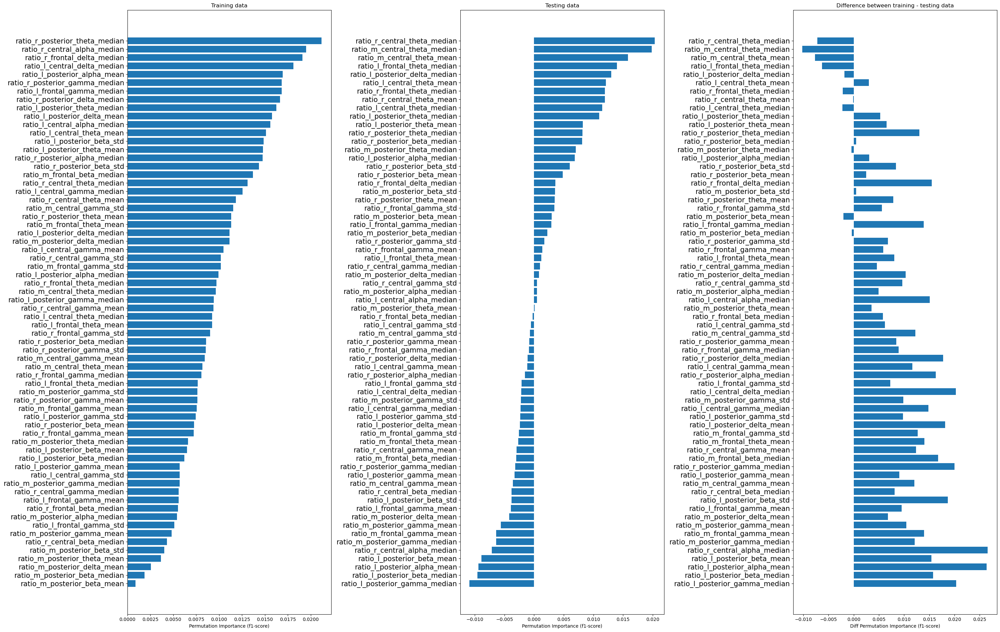

In [15]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')
ax1.tick_params(axis='y', labelsize=15)  # Adjust font size

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')
ax2.tick_params(axis='y', labelsize=15)  # Adjust font size

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')
ax3.tick_params(axis='y', labelsize=15)  # Adjust font size

plt.subplots_adjust(wspace=0.5)  # Increase the width space between subplots
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the layout to fit everything nicely
plt.show()

#### EC feature set

In [ ]:
from sklearn import svm
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.svm import SVC
from sklearn.multiclass import OneVsRestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_features_ec['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_features_ec.columns if 'EC' in num_col]
 
X = df_stat_features_ec[numeric_cols]
Y = df_stat_features_ec['diagnosis']
# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# hyperparameter ranges for GridSearch
param_grid = {
'rbf_svm__estimator__C': [0.01, 0.1, 1, 10, 100],
'rbf_svm__estimator__gamma': [0.1, 1, 10, 100],
'rbf_svm__estimator__kernel': ['rbf'],
'rbf_svm__estimator__class_weight': ['balanced']
}

# final pipeline
steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(class_weight = 'balanced')))]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

# define gridsearch
gridsearch = GridSearchCV(pipeline,
                        param_grid = param_grid,
                        cv = cv_inner, # use inner cv for hyperparameter tuning
                        scoring = f1_scorer,
                        error_score = 'raise',
                        return_train_score = True,
                        n_jobs=-1,
                        verbose=1)

# nested CV with parameter optimization to compute testing score (f1-score)
nested_cv_gridsearch = cross_validate(gridsearch,
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 return_estimator=True,
                                 return_train_score = False,
                                 verbose=1,
                                 n_jobs=-1)
print('SVM test scores:', nested_cv_gridsearch['test_score'])
print('Mean SVM test score:', np.mean(nested_cv_gridsearch['test_score']))
print('STD SVM test score:', np.std(nested_cv_gridsearch['test_score']))

# obtain best model during nested CV
best_score_index = np.argmax(nested_cv_gridsearch['test_score'])
best_model = nested_cv_gridsearch['estimator'][best_score_index]
print('Parameters of the best model:', best_model.best_params_)


# of instances: 2700
(2700, 5)


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


SVM test scores: [0.26799392 0.28289344 0.20875805 0.27411337 0.30310368]
Mean SVM test score: 0.26737249081726544
STD SVM test score: 0.0316199195824491
Parameters of the best model: {'rbf_svm__estimator__C': 10, 'rbf_svm__estimator__class_weight': 'balanced', 'rbf_svm__estimator__gamma': 0.1, 'rbf_svm__estimator__kernel': 'rbf'}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   45.4s finished


In [ ]:
# save the nested CV
joblib.dump(nested_cv_gridsearch, 'nested_cv_stat_svm_ec.pkl', compress=3)

['nested_cv_stat_svm_ec.pkl']

{'C': 10, 'class_weight': 'balanced', 'gamma': 0.1, 'kernel': 'rbf'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   13.9s finished


f1_score: 0.2749983532652508

classification report:
               precision    recall  f1-score   support

        ADHD       0.40      0.31      0.35       540
     HEALTHY       0.34      0.27      0.30       540
         MDD       0.23      0.17      0.19       540
         OCD       0.19      0.13      0.16       540
         SMC       0.28      0.57      0.38       540

    accuracy                           0.29      2700
   macro avg       0.29      0.29      0.27      2700
weighted avg       0.29      0.29      0.27      2700



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   13.9s finished


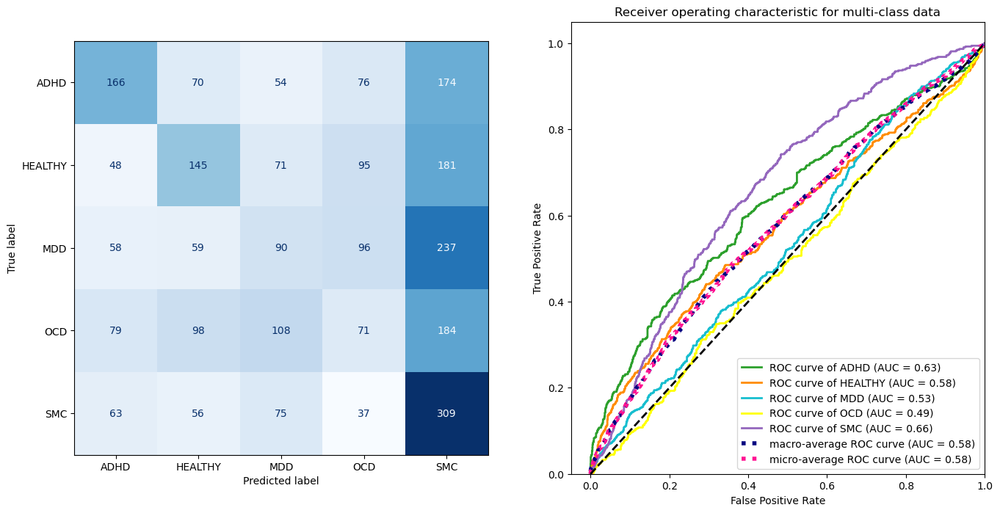

In [ ]:
# final pipeline
best_params = {}
for hyperparameter in best_model.best_params_:
    key = hyperparameter[20:]
    best_params[key] = best_model.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(**best_params, probability=True)))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

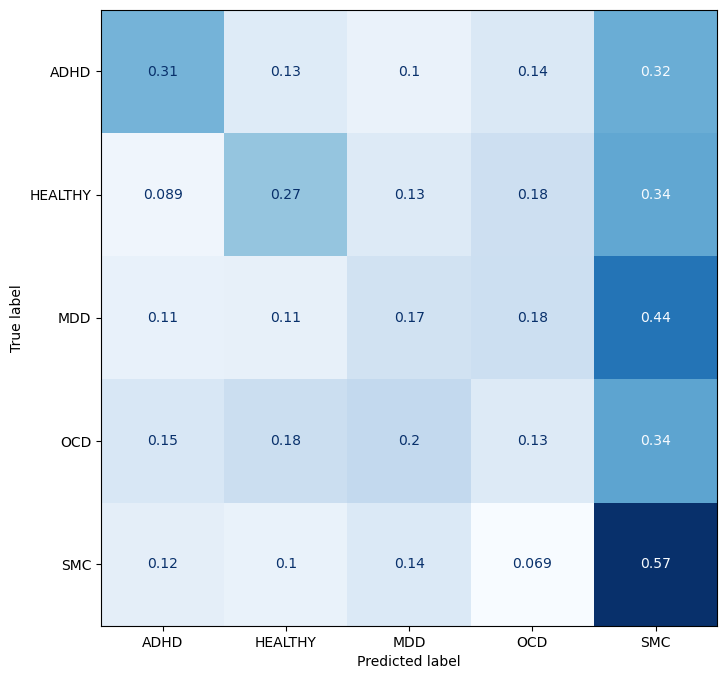

In [ ]:
# print the confusion matrix normalized by true labels
fig, ax = plt.subplots(figsize=(8,8))
conf_matrix = confusion_matrix(Y, Y_pred, normalize='true')
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', colorbar=False, ax=ax)

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 147), X_test.shape = (672, 147), Y_train.shape = (2028,), Y_test.shape = (672,)


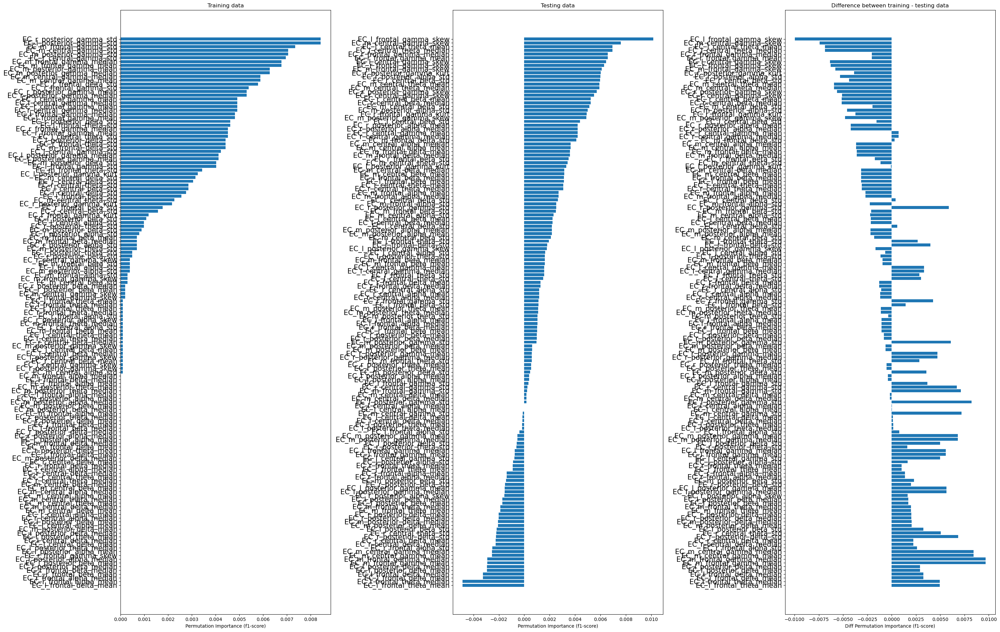

In [ ]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')
ax1.tick_params(axis='y', labelsize=15)  # Adjust font size

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')
ax2.tick_params(axis='y', labelsize=15)  # Adjust font size

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')
ax3.tick_params(axis='y', labelsize=15)  # Adjust font size

plt.subplots_adjust(wspace=0.5)  # Increase the width space between subplots
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the layout to fit everything nicely
plt.show()

#### EO feature set

In [21]:
from sklearn import svm
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.svm import SVC
from sklearn.multiclass import OneVsRestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_features_eo['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_features_eo.columns if 'EO' in num_col]
 
X = df_stat_features_eo[numeric_cols]
Y = df_stat_features_eo['diagnosis']
# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# hyperparameter ranges for GridSearch
param_grid = {
'rbf_svm__estimator__C': [0.01, 0.1, 1, 10, 100],
'rbf_svm__estimator__gamma': [0.1, 1, 10, 100],
'rbf_svm__estimator__kernel': ['rbf'],
'rbf_svm__estimator__class_weight': ['balanced']
}

# final pipeline
steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(class_weight = 'balanced')))]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

# define gridsearch
gridsearch = GridSearchCV(pipeline,
                        param_grid = param_grid,
                        cv = cv_inner, # use inner cv for hyperparameter tuning
                        scoring = f1_scorer,
                        error_score = 'raise',
                        return_train_score = True,
                        n_jobs=-1,
                        verbose=1)

# nested CV with parameter optimization to compute testing score (f1-score)
nested_cv_gridsearch = cross_validate(gridsearch,
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 return_estimator=True,
                                 return_train_score = False,
                                 verbose=1,
                                 n_jobs=-1)
print('SVM test scores:', nested_cv_gridsearch['test_score'])
print('Mean SVM test score:', np.mean(nested_cv_gridsearch['test_score']))
print('STD SVM test score:', np.std(nested_cv_gridsearch['test_score']))

# obtain best model during nested CV
best_score_index = np.argmax(nested_cv_gridsearch['test_score'])
best_model = nested_cv_gridsearch['estimator'][best_score_index]
print('Parameters of the best model:', best_model.best_params_)


# of instances: 2700
(2700, 5)


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
SVM test scores: [0.38871635 0.3708784  0.26908511 0.27943377 0.32383937]
Mean SVM test score: 0.3263906006311722
STD SVM test score: 0.047663479454831875
Parameters of the best model: {'rbf_svm__estimator__C': 1, 'rbf_svm__estimator__class_weight': 'balanced', 'rbf_svm__estimator__gamma': 0.1, 'rbf_svm__estimator__kernel': 'rbf'}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   41.4s finished


In [22]:
# save the nested CV
joblib.dump(nested_cv_gridsearch, 'nested_cv_stat_svm_ec.pkl', compress=3)

['nested_cv_stat_svm_ec.pkl']

{'C': 1, 'class_weight': 'balanced', 'gamma': 0.1, 'kernel': 'rbf'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   13.1s finished


f1_score: 0.32734557308107715

classification report:
               precision    recall  f1-score   support

        ADHD       0.50      0.39      0.44       540
     HEALTHY       0.35      0.28      0.31       540
         MDD       0.23      0.15      0.18       540
         OCD       0.32      0.21      0.25       540
         SMC       0.34      0.71      0.46       540

    accuracy                           0.35      2700
   macro avg       0.35      0.35      0.33      2700
weighted avg       0.35      0.35      0.33      2700



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   12.8s finished


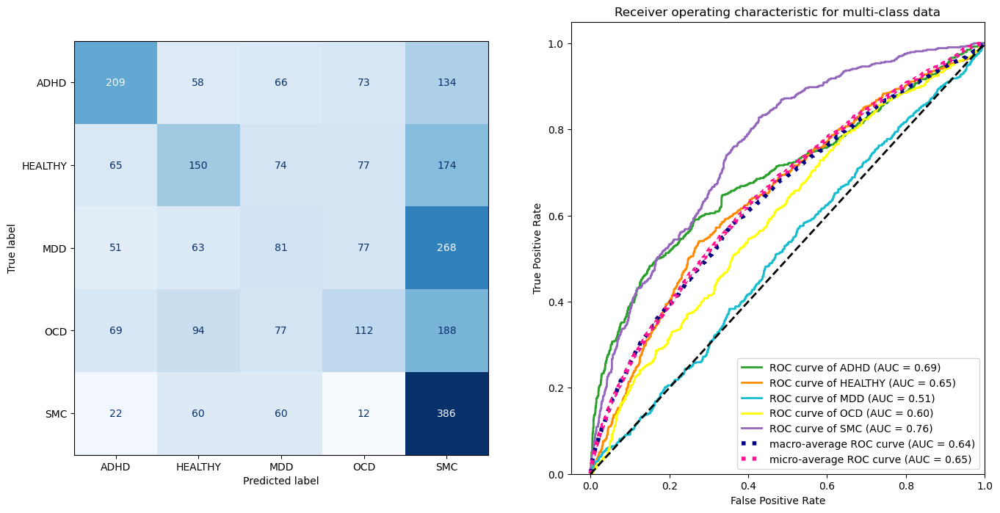

In [23]:
# final pipeline
best_params = {}
for hyperparameter in best_model.best_params_:
    key = hyperparameter[20:]
    best_params[key] = best_model.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(**best_params, probability=True)))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

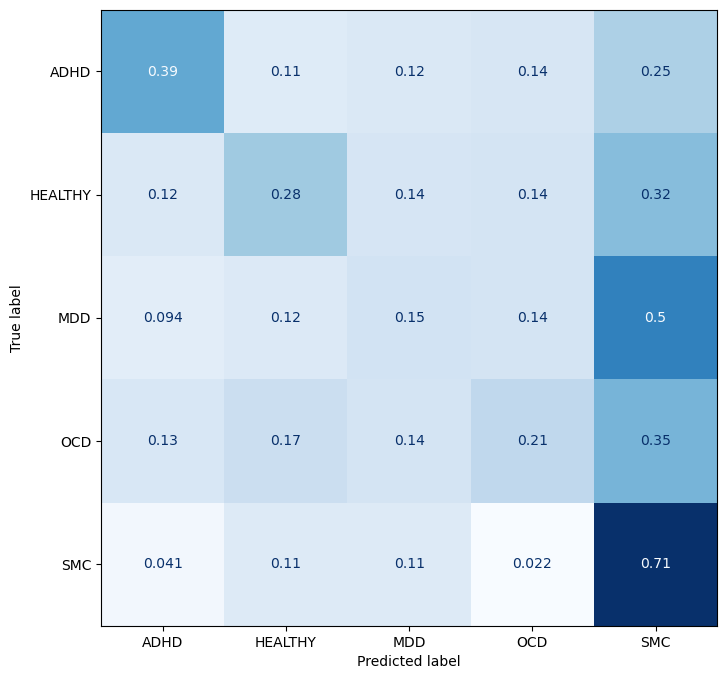

In [24]:
# print the confusion matrix normalized by true labels
fig, ax = plt.subplots(figsize=(8,8))
conf_matrix = confusion_matrix(Y, Y_pred, normalize='true')
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', colorbar=False, ax=ax)

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 135), X_test.shape = (672, 135), Y_train.shape = (2028,), Y_test.shape = (672,)


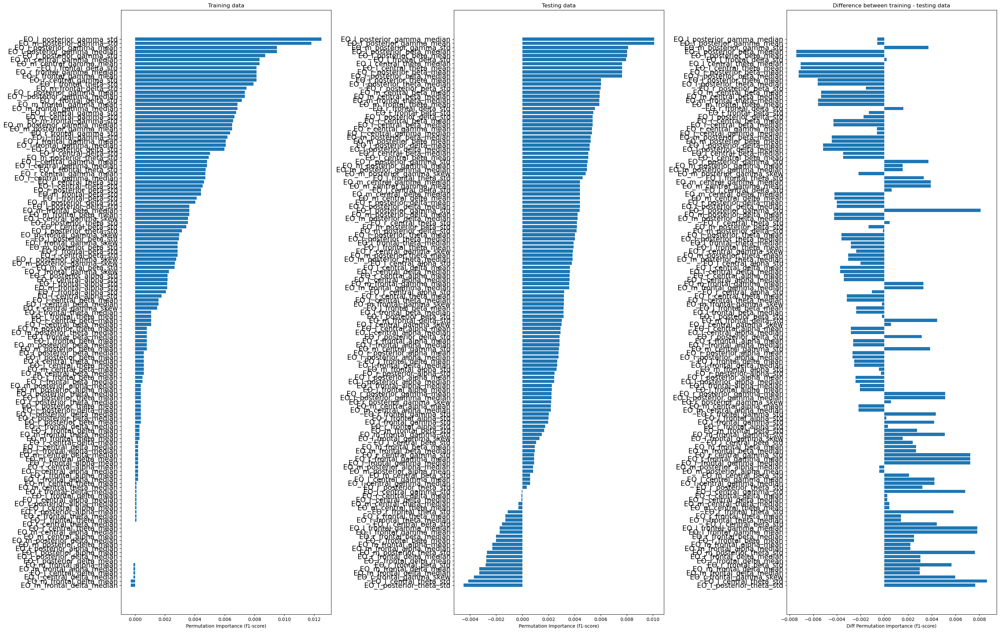

In [25]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')
ax1.tick_params(axis='y', labelsize=15)  # Adjust font size

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')
ax2.tick_params(axis='y', labelsize=15)  # Adjust font size

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')
ax3.tick_params(axis='y', labelsize=15)  # Adjust font size

plt.subplots_adjust(wspace=0.5)  # Increase the width space between subplots
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the layout to fit everything nicely
plt.show()

## Random Forest

#### ratio feature set

In [26]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import RandomForestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_features_ratio['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_features_ratio.columns if 'ratio' in num_col]
 
X = df_stat_features_ratio[numeric_cols]
Y = df_stat_features_ratio['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# final pipeline
steps = [('col_trans', col_trans), ('RF', RandomForestClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
max_features = ['log2', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'RF__n_estimators': n_estimators,
               'RF__max_features': max_features,
               'RF__max_depth': max_depth,
               'RF__min_samples_split': min_samples_split,
               'RF__min_samples_leaf': min_samples_leaf,
               'RF__bootstrap': bootstrap}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# nested CV with parameter optimization to compute testing score (f1-score)
nested_cv_randsearch = cross_validate(randsearch,
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 return_estimator=True,
                                 return_train_score = False,
                                 verbose=1,
                                 n_jobs=-1)
print('RF test scores:', nested_cv_randsearch['test_score'])
print('Mean RF test score:', np.mean(nested_cv_randsearch['test_score']))
print('STD RF test score:', np.std(nested_cv_randsearch['test_score']))

# obtain best model during nested CV
best_score_index = np.argmax(nested_cv_randsearch['test_score'])
best_model = nested_cv_randsearch['estimator'][best_score_index]
print('Parameters of the best model:', best_model.best_params_)


# of instances: 2700
(2700, 5)


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
RF test scores: [0.31903777 0.34500097 0.21313781 0.21045897 0.28504182]
Mean RF test score: 0.2745354675751591
STD RF test score: 0.054647404667205614
Parameters of the best model: {'RF__n_estimators': 400, 'RF__min_samples_split': 2, 'RF__min_samples_leaf'

[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 26.8min finished


In [27]:
# save the nested CV
joblib.dump(nested_cv_randsearch, 'nested_cv_stat_rf_ratio.pkl', compress=3)

['nested_cv_stat_rf_ratio.pkl']

{'n_estimators': 400, 'min_samples_split': 2, 'min_samples_leaf': 4, 'max_features': 'sqrt', 'max_depth': 60, 'bootstrap': True}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    6.7s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


f1_score: 0.2779101639832971

classification report:
               precision    recall  f1-score   support

        ADHD       0.39      0.46      0.42       540
     HEALTHY       0.27      0.32      0.29       540
         MDD       0.20      0.16      0.18       540
         OCD       0.24      0.24      0.24       540
         SMC       0.27      0.24      0.26       540

    accuracy                           0.28      2700
   macro avg       0.28      0.28      0.28      2700
weighted avg       0.28      0.28      0.28      2700



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    6.1s finished


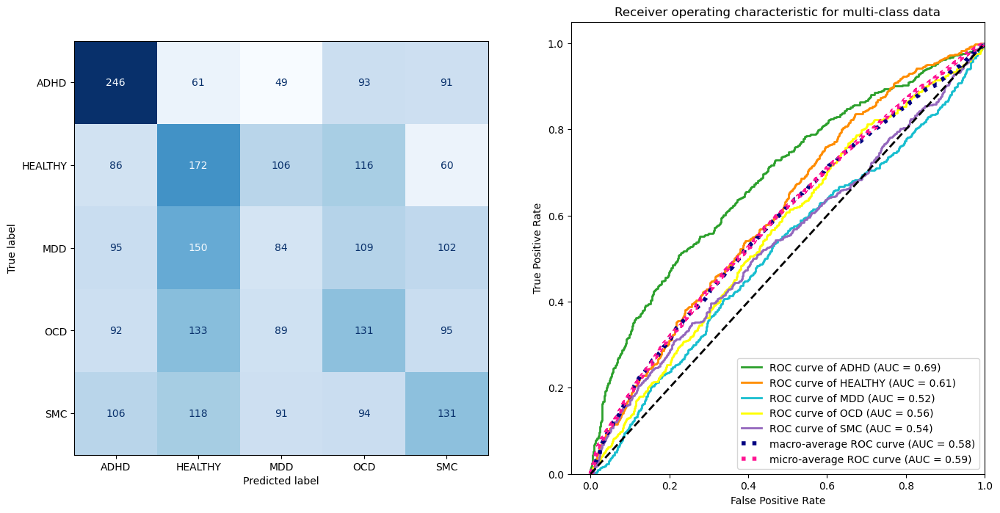

In [28]:
# final pipeline
best_params = {}
for hyperparameter in best_model.best_params_:
    key = hyperparameter[4:]
    best_params[key] = best_model.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('RF', RandomForestClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

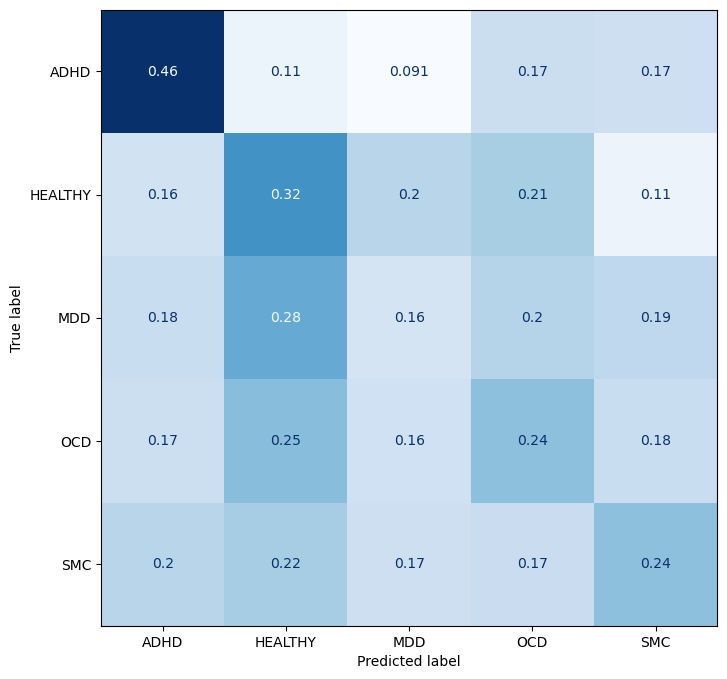

In [29]:
# print the confusion matrix normalized by true labels
fig, ax = plt.subplots(figsize=(8,8))
conf_matrix = confusion_matrix(Y, Y_pred, normalize='true')
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', colorbar=False, ax=ax)

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 66), X_test.shape = (672, 66), Y_train.shape = (2028,), Y_test.shape = (672,)


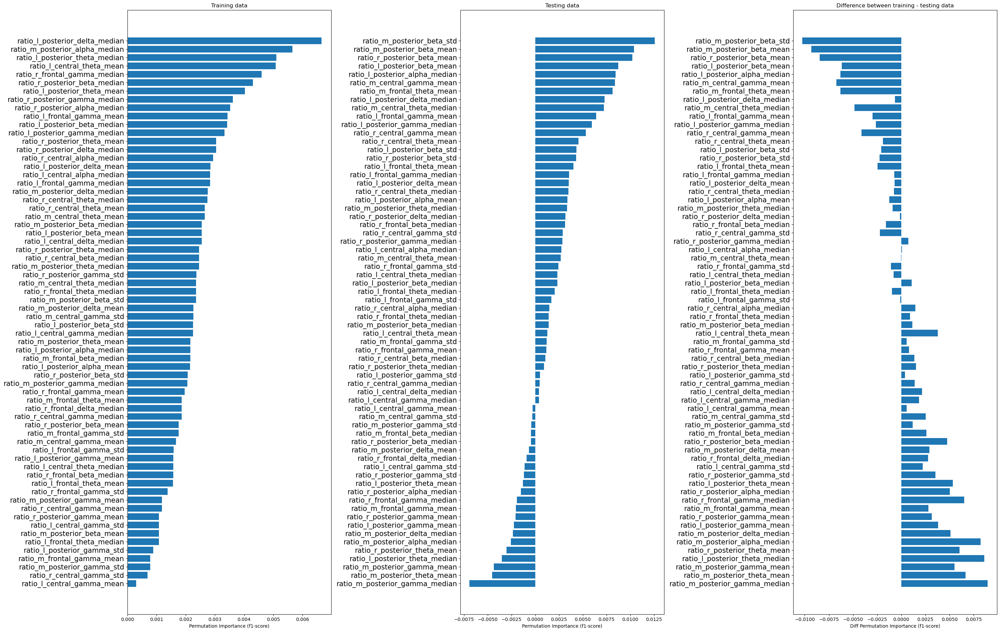

In [30]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')
ax1.tick_params(axis='y', labelsize=15)  # Adjust font size

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')
ax2.tick_params(axis='y', labelsize=15)  # Adjust font size

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')
ax3.tick_params(axis='y', labelsize=15)  # Adjust font size

plt.subplots_adjust(wspace=0.5)  # Increase the width space between subplots
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the layout to fit everything nicely
plt.show()

#### EC feature set

In [31]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import RandomForestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_features_ec['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_features_ec.columns if 'EC' in num_col]
 
X = df_stat_features_ec[numeric_cols]
Y = df_stat_features_ec['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# final pipeline
steps = [('col_trans', col_trans), ('RF', RandomForestClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
max_features = ['log2', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'RF__n_estimators': n_estimators,
               'RF__max_features': max_features,
               'RF__max_depth': max_depth,
               'RF__min_samples_split': min_samples_split,
               'RF__min_samples_leaf': min_samples_leaf,
               'RF__bootstrap': bootstrap}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# nested CV with parameter optimization to compute testing score (f1-score)
nested_cv_randsearch = cross_validate(randsearch,
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 return_estimator=True,
                                 return_train_score = False,
                                 verbose=1,
                                 n_jobs=-1)
print('RF test scores:', nested_cv_randsearch['test_score'])
print('Mean RF test score:', np.mean(nested_cv_randsearch['test_score']))
print('STD RF test score:', np.std(nested_cv_randsearch['test_score']))

# obtain best model during nested CV
best_score_index = np.argmax(nested_cv_randsearch['test_score'])
best_model = nested_cv_randsearch['estimator'][best_score_index]
print('Parameters of the best model:', best_model.best_params_)


# of instances: 2700
(2700, 5)


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
RF test scores: [0.3842019  0.35829376 0.34007812 0.35088256 0.35874554]
Mean RF test score: 0.35844037576864834
STD RF test score: 0.014546917311896463
Parameters of the best model: {'RF__n_estimators': 600, 'RF__min_samples_split': 10, 'RF__min_samples_leaf': 2, 'RF__max_features': 'log2', 'RF__max_depth': 100, 'RF__bootstrap': False}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 27.0min finished


In [32]:
# save the nested CV
joblib.dump(nested_cv_randsearch, 'nested_cv_stat_rf_ec.pkl', compress=3)

['nested_cv_stat_rf_ec.pkl']

{'n_estimators': 600, 'min_samples_split': 10, 'min_samples_leaf': 2, 'max_features': 'log2', 'max_depth': 100, 'bootstrap': False}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   12.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


f1_score: 0.36233620935551336

classification report:
               precision    recall  f1-score   support

        ADHD       0.45      0.42      0.43       540
     HEALTHY       0.40      0.44      0.42       540
         MDD       0.27      0.22      0.24       540
         OCD       0.32      0.32      0.32       540
         SMC       0.37      0.43      0.40       540

    accuracy                           0.37      2700
   macro avg       0.36      0.37      0.36      2700
weighted avg       0.36      0.37      0.36      2700



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   11.4s finished


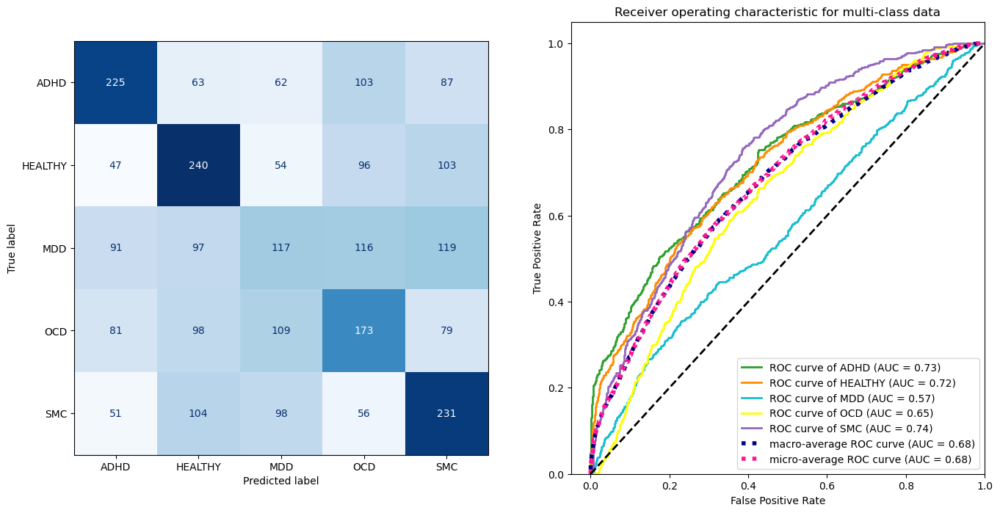

In [33]:
# final pipeline
best_params = {}
for hyperparameter in best_model.best_params_:
    key = hyperparameter[4:]
    best_params[key] = best_model.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('RF', RandomForestClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

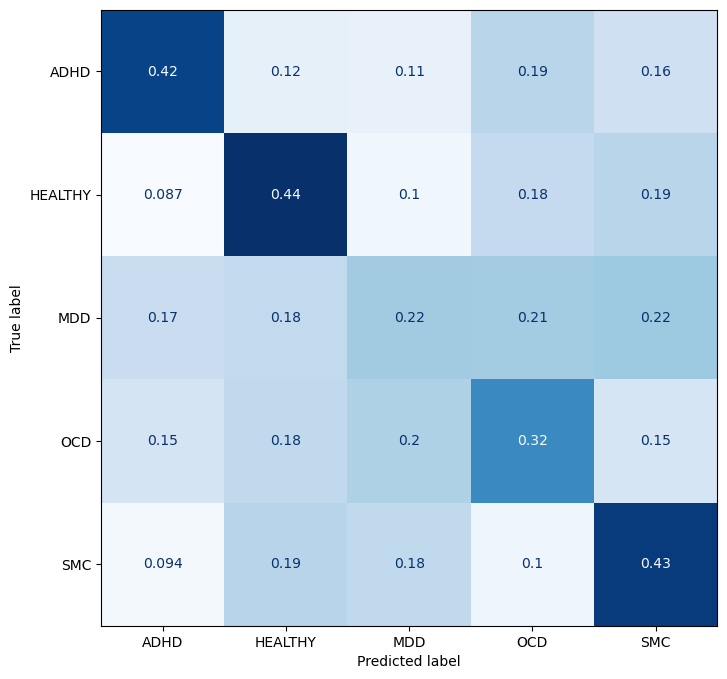

In [34]:
# print the confusion matrix normalized by true labels
fig, ax = plt.subplots(figsize=(8,8))
conf_matrix = confusion_matrix(Y, Y_pred, normalize='true')
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', colorbar=False, ax=ax)

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 147), X_test.shape = (672, 147), Y_train.shape = (2028,), Y_test.shape = (672,)


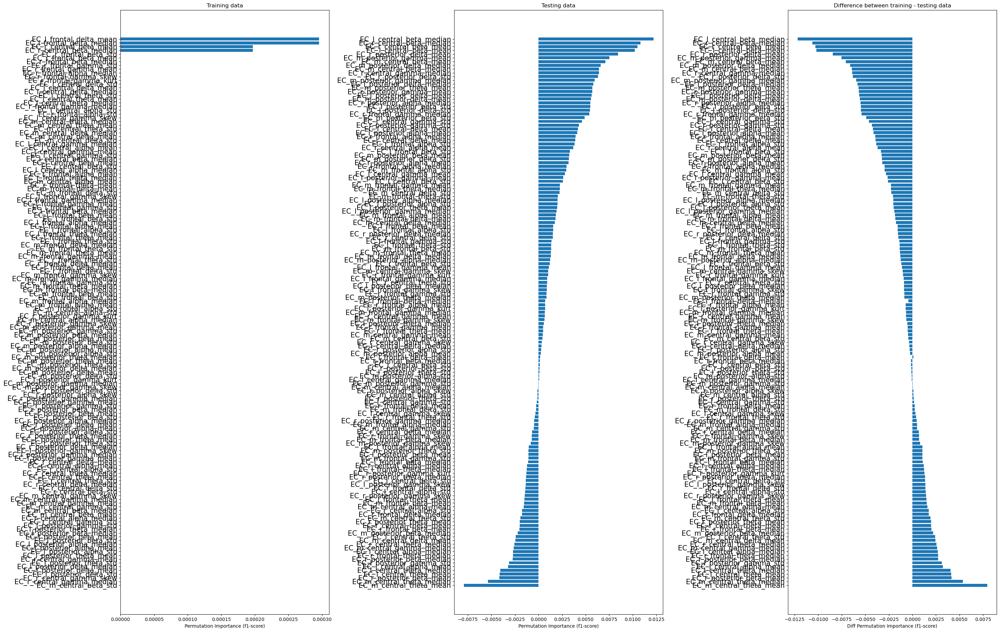

In [35]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')
ax1.tick_params(axis='y', labelsize=15)  # Adjust font size

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')
ax2.tick_params(axis='y', labelsize=15)  # Adjust font size

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')
ax3.tick_params(axis='y', labelsize=15)  # Adjust font size

plt.subplots_adjust(wspace=0.5)  # Increase the width space between subplots
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the layout to fit everything nicely
plt.show()

#### EO feature set

In [36]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import RandomForestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_features_eo['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_features_eo.columns if 'EO' in num_col]

X = df_stat_features_eo[numeric_cols]
Y = df_stat_features_eo['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# final pipeline
steps = [('col_trans', col_trans), ('RF', RandomForestClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
max_features = ['log2', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'RF__n_estimators': n_estimators,
               'RF__max_features': max_features,
               'RF__max_depth': max_depth,
               'RF__min_samples_split': min_samples_split,
               'RF__min_samples_leaf': min_samples_leaf,
               'RF__bootstrap': bootstrap}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# nested CV with parameter optimization to compute testing score (f1-score)
nested_cv_randsearch = cross_validate(randsearch,
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 return_estimator=True,
                                 return_train_score = False,
                                 verbose=1,
                                 n_jobs=-1)
print('RF test scores:', nested_cv_randsearch['test_score'])
print('Mean RF test score:', np.mean(nested_cv_randsearch['test_score']))
print('STD RF test score:', np.std(nested_cv_randsearch['test_score']))

# obtain best model during nested CV
best_score_index = np.argmax(nested_cv_randsearch['test_score'])
best_model = nested_cv_randsearch['estimator'][best_score_index]
print('Parameters of the best model:', best_model.best_params_)

# of instances: 2700
(2700, 5)


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
RF test scores: [0.397091   0.44488993 0.29822298 0.28142376 0.46355785]
Mean RF test score: 0.3770371022079984
STD RF test score: 0.07462651062390795
Parameters of the best model: {'RF__n_estimators': 400, 'RF__min_samples_split': 2, 'RF__min_samples_leaf': 1, 'RF__max_features': 'log2', 'RF__max_depth': 80, 'RF__bootstrap': True}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 28.7min finished


In [37]:
# save the nested CV
joblib.dump(nested_cv_randsearch, 'nested_cv_stat_rf_eo.pkl', compress=3)

['nested_cv_stat_rf_eo.pkl']

{'n_estimators': 400, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'log2', 'max_depth': 80, 'bootstrap': True}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    6.3s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


f1_score: 0.3718640254067264

classification report:
               precision    recall  f1-score   support

        ADHD       0.49      0.49      0.49       540
     HEALTHY       0.35      0.42      0.38       540
         MDD       0.25      0.20      0.22       540
         OCD       0.35      0.31      0.33       540
         SMC       0.41      0.46      0.44       540

    accuracy                           0.38      2700
   macro avg       0.37      0.38      0.37      2700
weighted avg       0.37      0.38      0.37      2700



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    5.6s finished


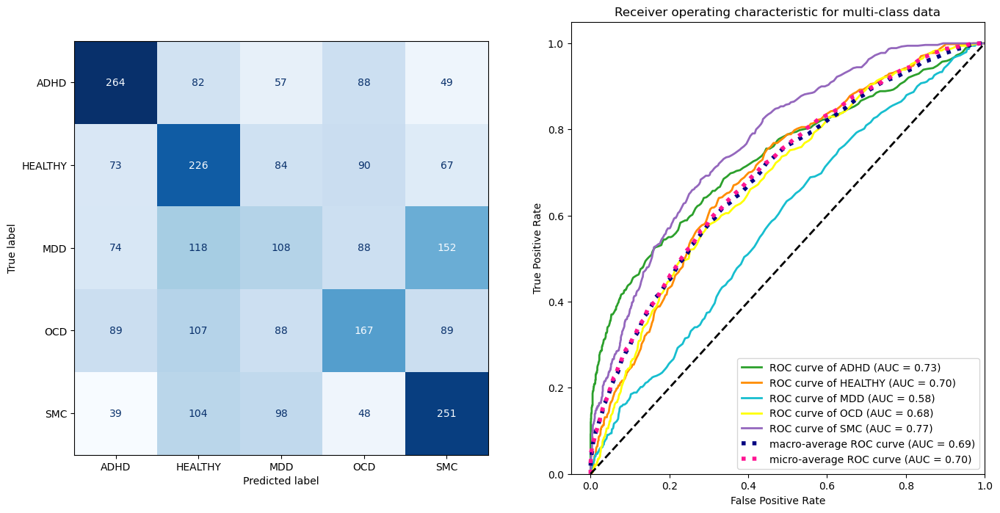

In [38]:
# final pipeline
best_params = {}
for hyperparameter in best_model.best_params_:
    key = hyperparameter[4:]
    best_params[key] = best_model.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('RF', RandomForestClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

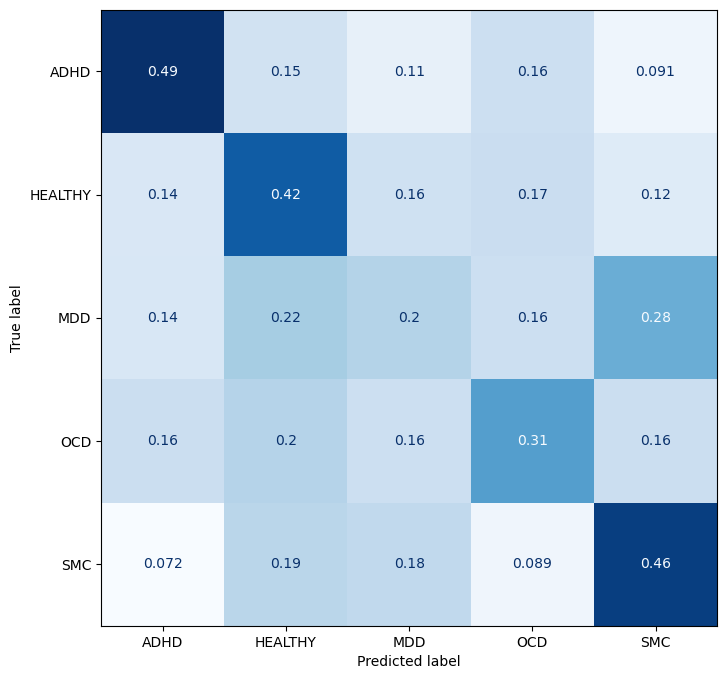

In [39]:
# print the confusion matrix normalized by true labels
fig, ax = plt.subplots(figsize=(8,8))
conf_matrix = confusion_matrix(Y, Y_pred, normalize='true')
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', colorbar=False, ax=ax)

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 135), X_test.shape = (672, 135), Y_train.shape = (2028,), Y_test.shape = (672,)


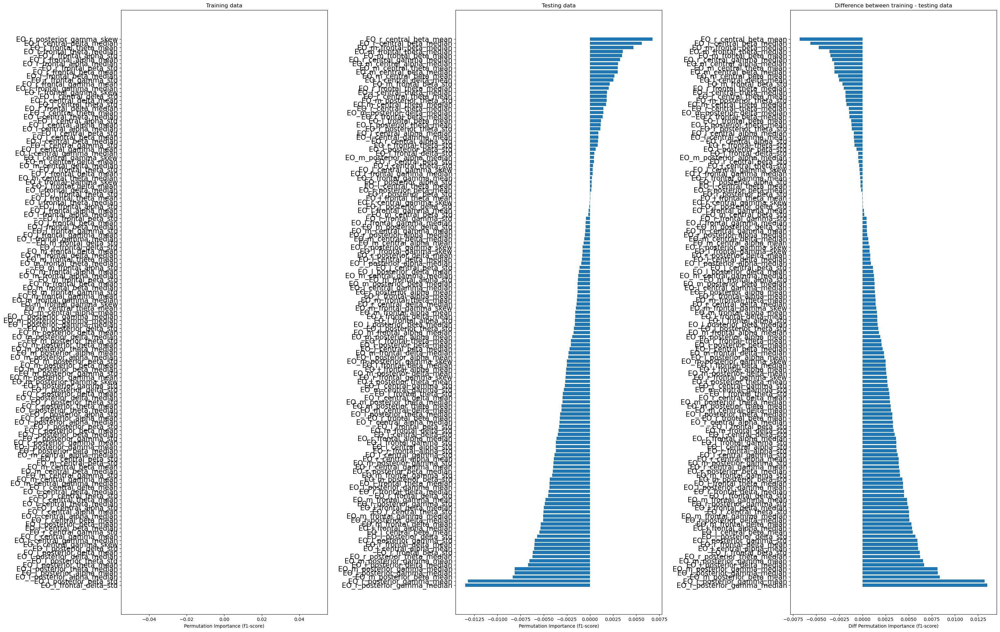

In [40]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')
ax1.tick_params(axis='y', labelsize=15)  # Adjust font size

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')
ax2.tick_params(axis='y', labelsize=15)  # Adjust font size

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')
ax3.tick_params(axis='y', labelsize=15)  # Adjust font size

plt.subplots_adjust(wspace=0.5)  # Increase the width space between subplots
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the layout to fit everything nicely
plt.show()

## GradientBoostingClassifier

#### ratio feature set

In [41]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import GradientBoostingClassifier
from scipy.stats import loguniform


# assign groups (IDs) for GroupKFold
groups = df_stat_features_ratio['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_features_ratio.columns if 'ratio' in num_col]
 
X = df_stat_features_ratio[numeric_cols]
Y = df_stat_features_ratio['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)


# final pipeline
steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of boosting stages to perform
n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1000, num = 10)]
# Loss function to be optimized
loss = ['log_loss']
# Learning rate
learning_rate = loguniform.rvs(0.001, 0.1, size=1000)
# Fraction of samples to be used for fitting the individual base learners
subsample = [x for x in np.linspace(0.5, 1, 5)]
# The function to measure the quality of the split
criterion = ['friedman_mse']
# The min number of samples required to split an internal node
min_samples_split = [2, 5, 10]
# Create the random grid
random_grid = {'gbc__n_estimators': n_estimators,
               'gbc__loss': loss,
               'gbc__learning_rate': learning_rate,
               'gbc__subsample': subsample,
               'gbc__criterion': criterion,
               'gbc__min_samples_split': min_samples_split}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# nested CV with parameter optimization to compute testing score (f1-score)
nested_cv_randsearch = cross_validate(randsearch,
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 return_estimator=True,
                                 return_train_score = False,
                                 verbose=1,
                                 n_jobs=-1)
print('GBC test scores:', nested_cv_randsearch['test_score'])
print('Mean GBC test score:', np.mean(nested_cv_randsearch['test_score']))
print('STD GBC test score:', np.std(nested_cv_randsearch['test_score']))

# obtain best model during nested CV
best_score_index = np.argmax(nested_cv_randsearch['test_score'])
best_model = nested_cv_randsearch['estimator'][best_score_index]
print('Parameters of the best model:', best_model.best_params_)


# of instances: 2700
(2700, 5)


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2


Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
GBC test scores: [0.31101287 0.31980545 0.2213418  0.24075669 0.26704599]
Mean GBC test score: 0.271992560293904
STD GBC test score: 0.03840391901971684
Parameters of the best model: {'gbc__subsample': 1.0, 'gbc__n_estimators': 300, 'gbc__min_samples_split': 2, 'gbc__loss': 'log_loss', 'gbc__learning_rate': 0.0031815429912507897, 'gbc__criterion': 'friedman_mse'}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 98.6min finished


In [42]:
# save the nested CV
joblib.dump(nested_cv_randsearch, 'nested_cv_stat_gbc_ratio.pkl', compress=3)

['nested_cv_stat_gbc_ratio.pkl']

{'subsample': 1.0, 'n_estimators': 300, 'min_samples_split': 2, 'loss': 'log_loss', 'learning_rate': 0.0031815429912507897, 'criterion': 'friedman_mse'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  1.3min finished


f1_score: 0.2732092547063689

classification report:
               precision    recall  f1-score   support

        ADHD       0.37      0.40      0.38       540
     HEALTHY       0.30      0.28      0.29       540
         MDD       0.22      0.14      0.17       540
         OCD       0.24      0.36      0.29       540
         SMC       0.26      0.22      0.24       540

    accuracy                           0.28      2700
   macro avg       0.28      0.28      0.27      2700
weighted avg       0.28      0.28      0.27      2700



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  1.2min finished


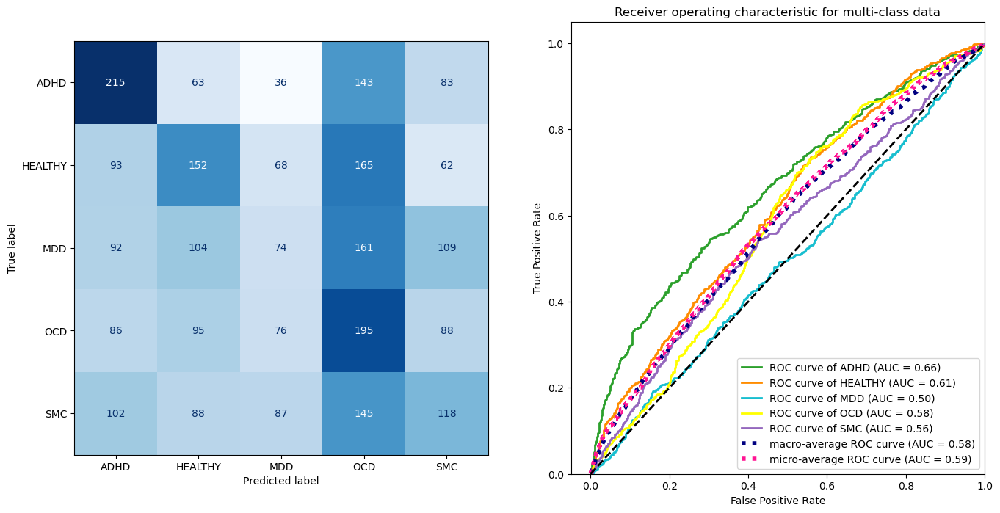

In [43]:
# final pipeline
best_params = {}
for hyperparameter in best_model.best_params_:
    key = hyperparameter[5:]
    best_params[key] = best_model.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

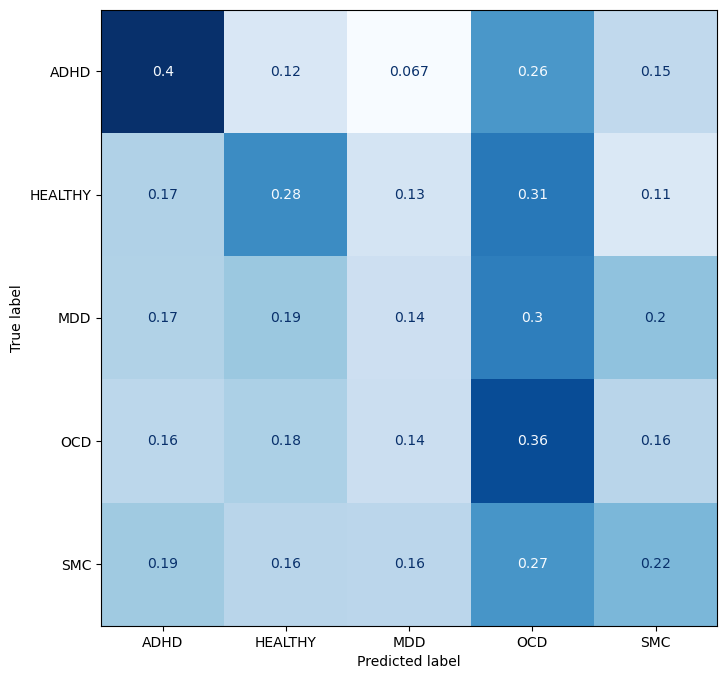

In [44]:
# print the confusion matrix normalized by true labels
fig, ax = plt.subplots(figsize=(8,8))
conf_matrix = confusion_matrix(Y, Y_pred, normalize='true')
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', colorbar=False, ax=ax)

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 66), X_test.shape = (672, 66), Y_train.shape = (2028,), Y_test.shape = (672,)


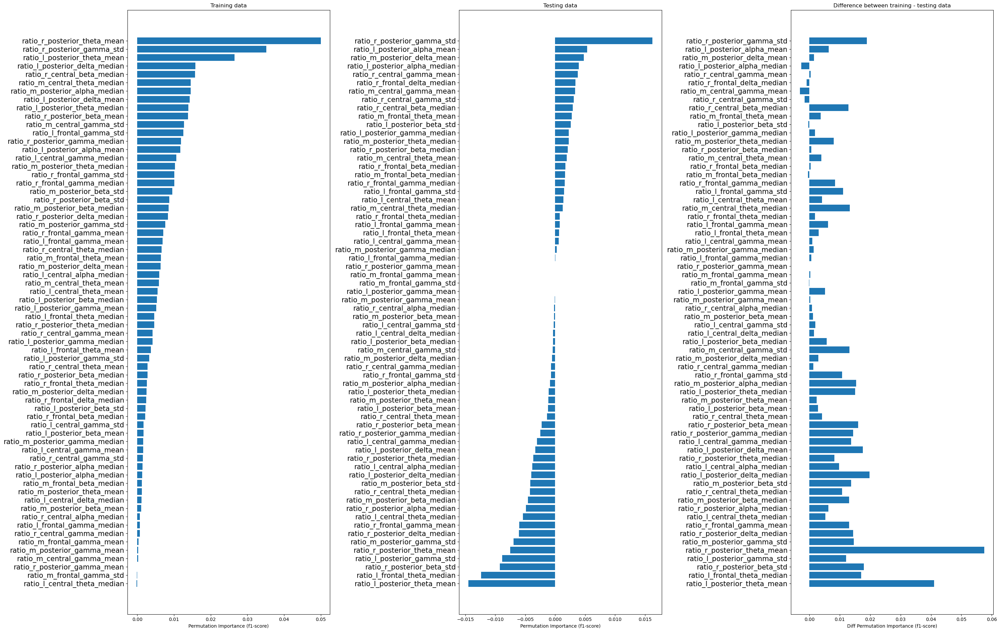

In [45]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')
ax1.tick_params(axis='y', labelsize=15)  # Adjust font size

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')
ax2.tick_params(axis='y', labelsize=15)  # Adjust font size

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')
ax3.tick_params(axis='y', labelsize=15)  # Adjust font size

plt.subplots_adjust(wspace=0.5)  # Increase the width space between subplots
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the layout to fit everything nicely
plt.show()

#### EC feature set

In [46]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import GradientBoostingClassifier
from scipy.stats import loguniform


# assign groups (IDs) for GroupKFold
groups = df_stat_features_ec['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_features_ec.columns if 'EC' in num_col]
 
X = df_stat_features_ec[numeric_cols]
Y = df_stat_features_ec['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)


# final pipeline
steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of boosting stages to perform
n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1000, num = 10)]
# Loss function to be optimized
loss = ['log_loss']
# Learning rate
learning_rate = loguniform.rvs(0.001, 0.1, size=1000)
# Fraction of samples to be used for fitting the individual base learners
subsample = [x for x in np.linspace(0.5, 1, 5)]
# The function to measure the quality of the split
criterion = ['friedman_mse']
# The min number of samples required to split an internal node
min_samples_split = [2, 5, 10]
# Create the random grid
random_grid = {'gbc__n_estimators': n_estimators,
               'gbc__loss': loss,
               'gbc__learning_rate': learning_rate,
               'gbc__subsample': subsample,
               'gbc__criterion': criterion,
               'gbc__min_samples_split': min_samples_split}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# nested CV with parameter optimization to compute testing score (f1-score)
nested_cv_randsearch = cross_validate(randsearch,
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 return_estimator=True,
                                 return_train_score = False,
                                 verbose=1,
                                 n_jobs=-1)
print('GBC test scores:', nested_cv_randsearch['test_score'])
print('Mean GBC test score:', np.mean(nested_cv_randsearch['test_score']))
print('STD GBC test score:', np.std(nested_cv_randsearch['test_score']))

# obtain best model during nested CV
best_score_index = np.argmax(nested_cv_randsearch['test_score'])
best_model = nested_cv_randsearch['estimator'][best_score_index]
print('Parameters of the best model:', best_model.best_params_)

# of instances: 2700
(2700, 5)


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
GBC test scores: [0.40512246 0.36990388 0.34411133 0.3559953  0.3934206 ]
Mean GBC test score: 0.3737107146346482
STD GBC test score: 0.022713999109198305
Parameters of the best model: {'gbc__subsample': 0.5, 'gbc__n_estimators': 500, 'gbc__min_samples_split': 5, 'gbc__loss': 'log_loss', 'gbc__learning_rate': 0.008380358985673617, 'gbc__criterion': 'friedman_mse'}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 133.6min finished


In [47]:
# save the nested CV
joblib.dump(nested_cv_randsearch, 'nested_cv_stat_gbc_ec.pkl', compress=3)

['nested_cv_stat_gbc_ec.pkl']

{'subsample': 0.5, 'n_estimators': 500, 'min_samples_split': 5, 'loss': 'log_loss', 'learning_rate': 0.008380358985673617, 'criterion': 'friedman_mse'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  2.2min finished


f1_score: 0.38960662411960856

classification report:
               precision    recall  f1-score   support

        ADHD       0.46      0.47      0.46       540
     HEALTHY       0.43      0.43      0.43       540
         MDD       0.31      0.26      0.29       540
         OCD       0.33      0.32      0.32       540
         SMC       0.42      0.48      0.45       540

    accuracy                           0.39      2700
   macro avg       0.39      0.39      0.39      2700
weighted avg       0.39      0.39      0.39      2700



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  2.2min finished


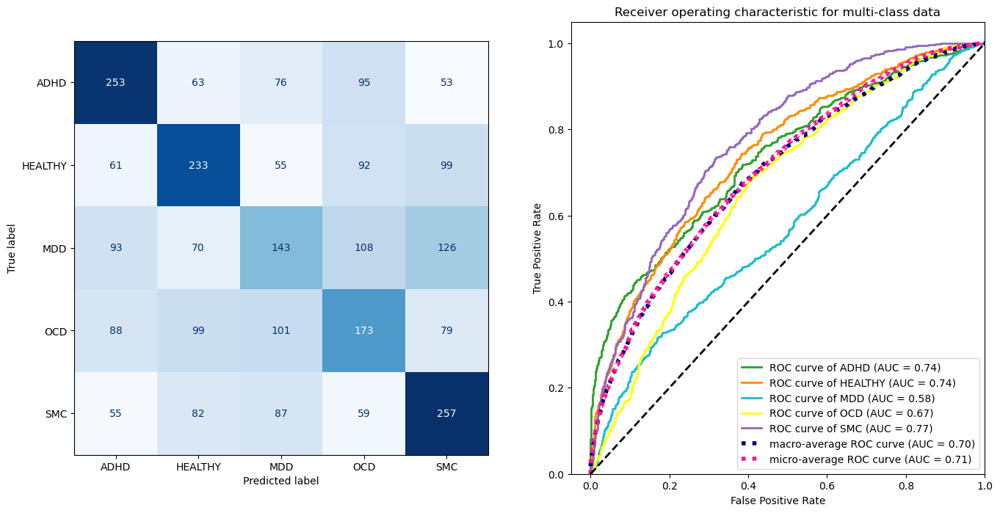

In [48]:
# final pipeline
best_params = {}
for hyperparameter in best_model.best_params_:
    key = hyperparameter[5:]
    best_params[key] = best_model.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

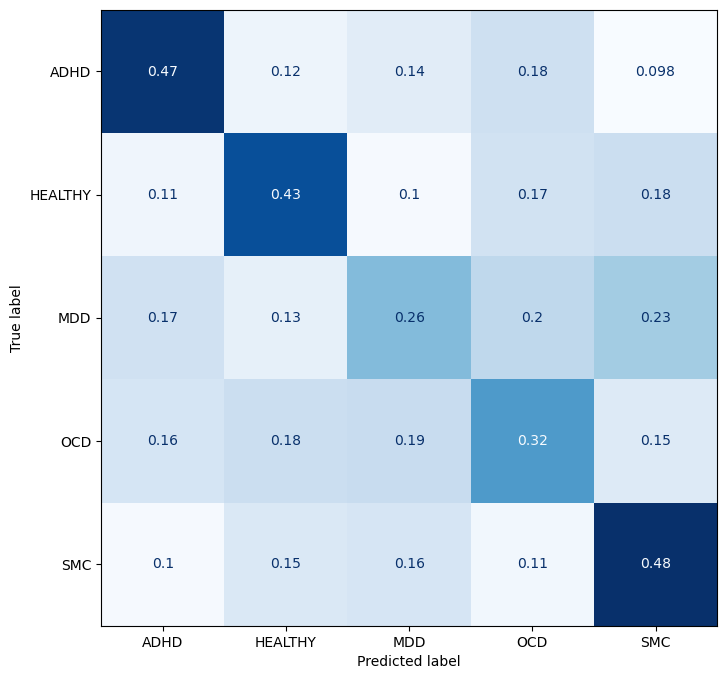

In [49]:
# print the confusion matrix normalized by true labels
fig, ax = plt.subplots(figsize=(8,8))
conf_matrix = confusion_matrix(Y, Y_pred, normalize='true')
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', colorbar=False, ax=ax)

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 147), X_test.shape = (672, 147), Y_train.shape = (2028,), Y_test.shape = (672,)


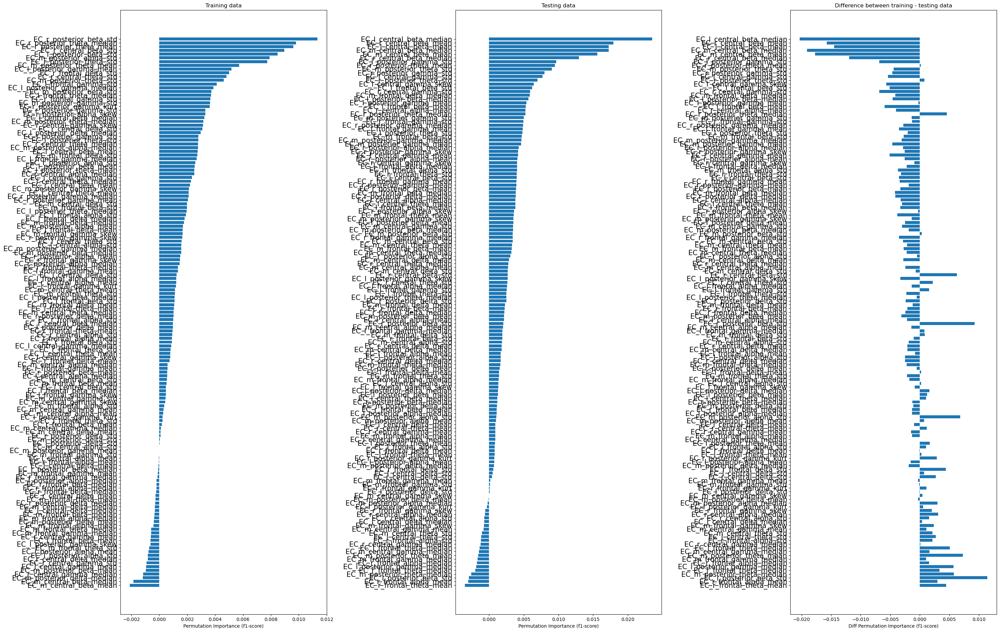

In [50]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')
ax1.tick_params(axis='y', labelsize=15)  # Adjust font size

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')
ax2.tick_params(axis='y', labelsize=15)  # Adjust font size

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')
ax3.tick_params(axis='y', labelsize=15)  # Adjust font size

plt.subplots_adjust(wspace=0.5)  # Increase the width space between subplots
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the layout to fit everything nicely
plt.show()

#### EO feature set

In [51]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import GradientBoostingClassifier
from scipy.stats import loguniform


# assign groups (IDs) for GroupKFold
groups = df_stat_features_eo['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_features_eo.columns if 'EO' in num_col]
 
X = df_stat_features_eo[numeric_cols]
Y = df_stat_features_eo['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)


# final pipeline
steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of boosting stages to perform
n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1000, num = 10)]
# Loss function to be optimized
loss = ['log_loss']
# Learning rate
learning_rate = loguniform.rvs(0.001, 0.1, size=1000)
# Fraction of samples to be used for fitting the individual base learners
subsample = [x for x in np.linspace(0.5, 1, 5)]
# The function to measure the quality of the split
criterion = ['friedman_mse']
# The min number of samples required to split an internal node
min_samples_split = [2, 5, 10]
# Create the random grid
random_grid = {'gbc__n_estimators': n_estimators,
               'gbc__loss': loss,
               'gbc__learning_rate': learning_rate,
               'gbc__subsample': subsample,
               'gbc__criterion': criterion,
               'gbc__min_samples_split': min_samples_split}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# nested CV with parameter optimization to compute testing score (f1-score)
nested_cv_randsearch = cross_validate(randsearch,
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 return_estimator=True,
                                 return_train_score = False,
                                 verbose=1,
                                 n_jobs=-1)
print('GBC test scores:', nested_cv_randsearch['test_score'])
print('Mean GBC test score:', np.mean(nested_cv_randsearch['test_score']))
print('STD GBC test score:', np.std(nested_cv_randsearch['test_score']))

# obtain best model during nested CV
best_score_index = np.argmax(nested_cv_randsearch['test_score'])
best_model = nested_cv_randsearch['estimator'][best_score_index]
print('Parameters of the best model:', best_model.best_params_)

# of instances: 2700
(2700, 5)


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
GBC test scores: [0.42733903 0.41759835 0.31407906 0.31259853 0.43981832]
Mean GBC test score: 0.38228665676041546
STD GBC test score: 0.05673664447163016
Parameters of the best model: {'gbc__subsample': 0.625, 'gbc__n_estimators': 1000, 'gbc__min_samples_split': 5, 'gbc__loss': 'log_loss', 'gbc__learning_rate': 0.06052833507809957, 'gbc__criterion': 'friedman_mse'}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 118.3min finished


In [52]:
# save the nested CV
joblib.dump(nested_cv_randsearch, 'grid_stat_gbc_eo.pkl', compress=3)

['grid_stat_gbc_eo.pkl']

{'subsample': 0.625, 'n_estimators': 1000, 'min_samples_split': 5, 'loss': 'log_loss', 'learning_rate': 0.06052833507809957, 'criterion': 'friedman_mse'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  5.1min finished


f1_score: 0.3908348268298554

classification report:
               precision    recall  f1-score   support

        ADHD       0.49      0.48      0.49       540
     HEALTHY       0.41      0.41      0.41       540
         MDD       0.27      0.27      0.27       540
         OCD       0.37      0.36      0.36       540
         SMC       0.41      0.44      0.43       540

    accuracy                           0.39      2700
   macro avg       0.39      0.39      0.39      2700
weighted avg       0.39      0.39      0.39      2700



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  5.1min finished


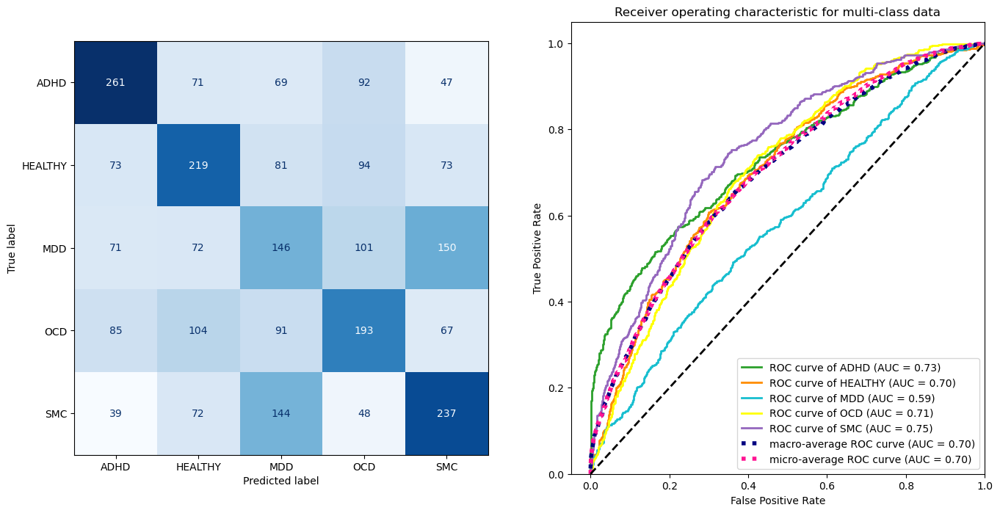

In [53]:
# final pipeline
best_params = {}
for hyperparameter in best_model.best_params_:
    key = hyperparameter[5:]
    best_params[key] = best_model.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

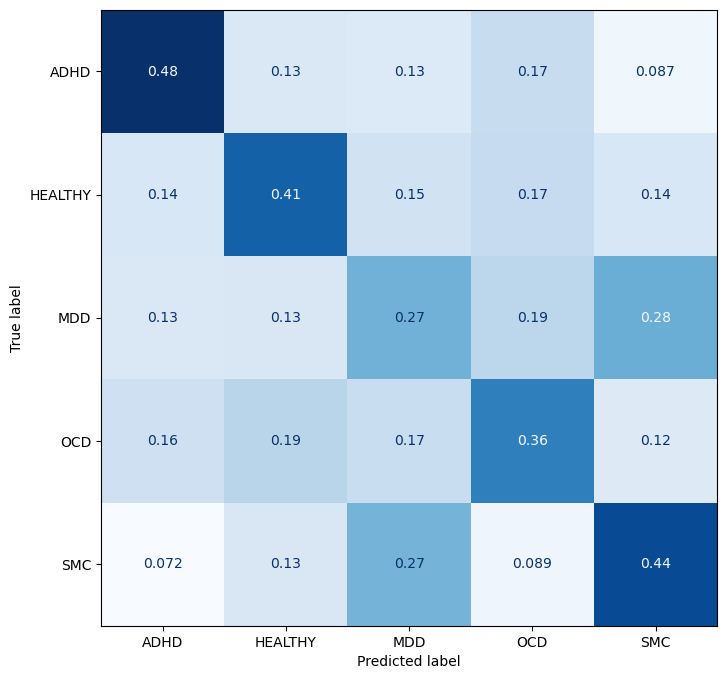

In [54]:
# print the confusion matrix normalized by true labels
fig, ax = plt.subplots(figsize=(8,8))
conf_matrix = confusion_matrix(Y, Y_pred, normalize='true')
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', colorbar=False, ax=ax)

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 135), X_test.shape = (672, 135), Y_train.shape = (2028,), Y_test.shape = (672,)


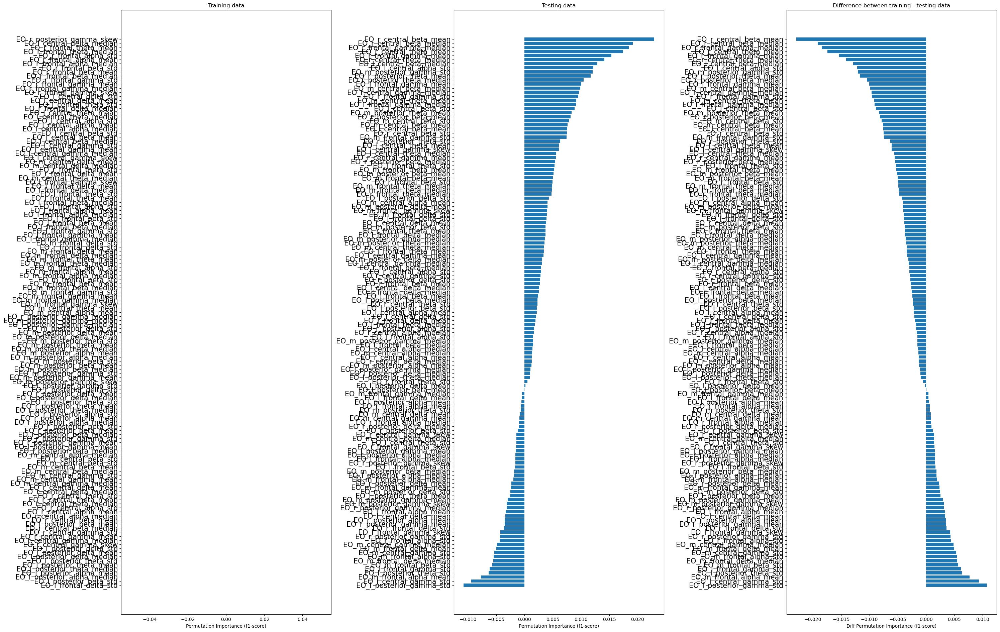

In [55]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')
ax1.tick_params(axis='y', labelsize=15)  # Adjust font size

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')
ax2.tick_params(axis='y', labelsize=15)  # Adjust font size

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')
ax3.tick_params(axis='y', labelsize=15)  # Adjust font size

plt.subplots_adjust(wspace=0.5)  # Increase the width space between subplots
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the layout to fit everything nicely
plt.show()

# 2. statistical + connectivity features

## SVC

#### ratio feature set

In [56]:
from sklearn import svm
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.svm import SVC
from sklearn.multiclass import OneVsRestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_conn_features_ratio['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_conn_features_ratio.columns if 'ratio' in num_col]
 
X = df_stat_conn_features_ratio[numeric_cols]
Y = df_stat_conn_features_ratio['diagnosis']
# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols),
    ],
    remainder='drop',
    n_jobs=-1)

# hyperparameter ranges for GridSearch
param_grid = {
'rbf_svm__estimator__C': [0.01, 0.1, 1, 10, 100],
'rbf_svm__estimator__gamma': [0.1, 1, 10, 100],
'rbf_svm__estimator__kernel': ['rbf'],
'rbf_svm__estimator__class_weight': ['balanced']
}

# final pipeline
steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(class_weight = 'balanced')))]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

# define gridsearch
gridsearch = GridSearchCV(pipeline,
                        param_grid = param_grid,
                        cv = cv_inner, # use inner cv for hyperparameter tuning
                        scoring = f1_scorer,
                        error_score = 'raise',
                        return_train_score = True,
                        n_jobs=-1,
                        verbose=1)

# nested CV with parameter optimization to compute testing score (f1-score)
nested_cv_gridsearch = cross_validate(gridsearch,
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 return_estimator=True,
                                 return_train_score = False,
                                 verbose=1,
                                 n_jobs=-1)
print('SVM test scores:', nested_cv_gridsearch['test_score'])
print('Mean SVM test score:', np.mean(nested_cv_gridsearch['test_score']))
print('STD SVM test score:', np.std(nested_cv_gridsearch['test_score']))

# obtain best model during nested CV
best_score_index = np.argmax(nested_cv_gridsearch['test_score'])
best_model = nested_cv_gridsearch['estimator'][best_score_index]
print('Parameters of the best model:', best_model.best_params_)

# of instances: 2700
(2700, 5)


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
SVM test scores: [0.20175346 0.21660407 0.17397969 0.15018683 0.16253967]
Mean SVM test score: 0.1810127431249416
STD SVM test score: 0.02464903561884662
Parameters of the best model: {'rbf_svm__estimator__C': 1, 'rbf_svm__estimator__class_weight': 'balanced', 'rbf_svm__estimator__gamma': 0.1, 'rbf_svm__estimator__kernel': 'rbf'}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   46.7s finished


In [57]:
# save the nested CV
joblib.dump(nested_cv_gridsearch, 'nested_cv_statconn_svm_ratio.pkl', compress=3)

Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits


['nested_cv_statconn_svm_ratio.pkl']

{'C': 1, 'class_weight': 'balanced', 'gamma': 0.1, 'kernel': 'rbf'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   13.7s finished


f1_score: 0.20047603643262982

classification report:
               precision    recall  f1-score   support

        ADHD       0.25      0.06      0.09       540
     HEALTHY       0.21      0.45      0.28       540
         MDD       0.20      0.11      0.14       540
         OCD       0.35      0.17      0.23       540
         SMC       0.21      0.33      0.26       540

    accuracy                           0.22      2700
   macro avg       0.24      0.22      0.20      2700
weighted avg       0.24      0.22      0.20      2700



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   13.5s finished


Micro-averaged One-vs-Rest ROC AUC score:
0.54


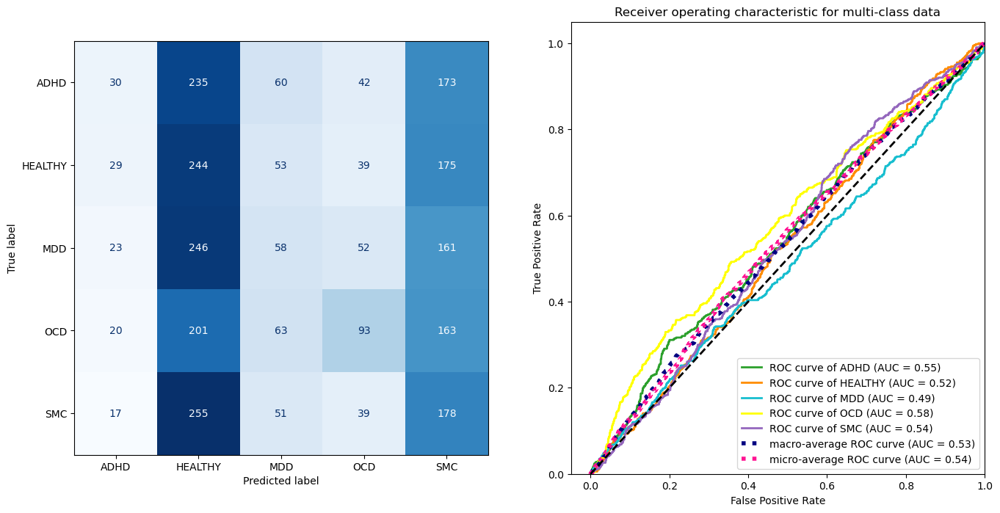

In [58]:
# final pipeline
best_params = {}
for hyperparameter in best_model.best_params_:
    key = hyperparameter[20:]
    best_params[key] = best_model.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(**best_params, probability=True)))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

from sklearn.metrics import roc_auc_score

micro_roc_auc_ovr = roc_auc_score(
    Y_one_hot,
    Y_score,
    multi_class="ovr",
    average="micro",
)

print(f"Micro-averaged One-vs-Rest ROC AUC score:\n{micro_roc_auc_ovr:.2f}")

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

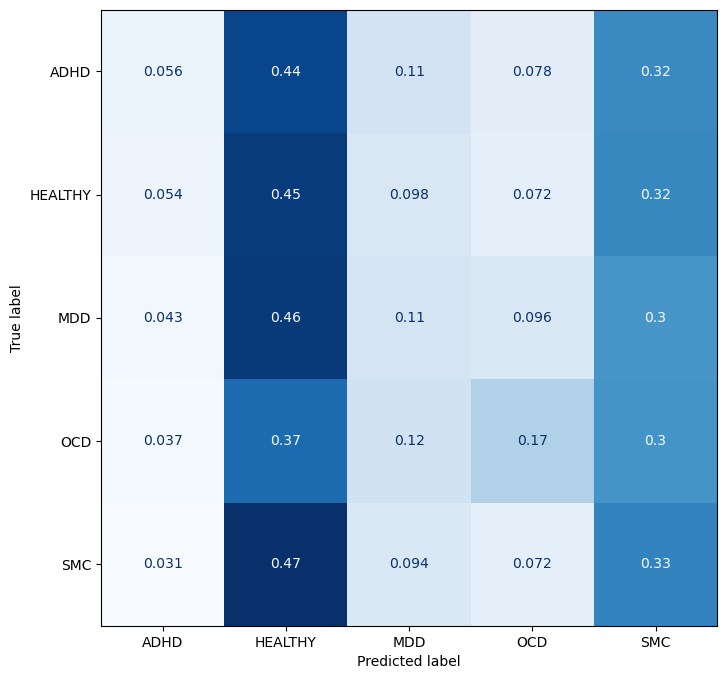

In [59]:
# print the confusion matrix normalized by true labels
fig, ax = plt.subplots(figsize=(8,8))
conf_matrix = confusion_matrix(Y, Y_pred, normalize='true')
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', colorbar=False, ax=ax)

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 182), X_test.shape = (672, 182), Y_train.shape = (2028,), Y_test.shape = (672,)


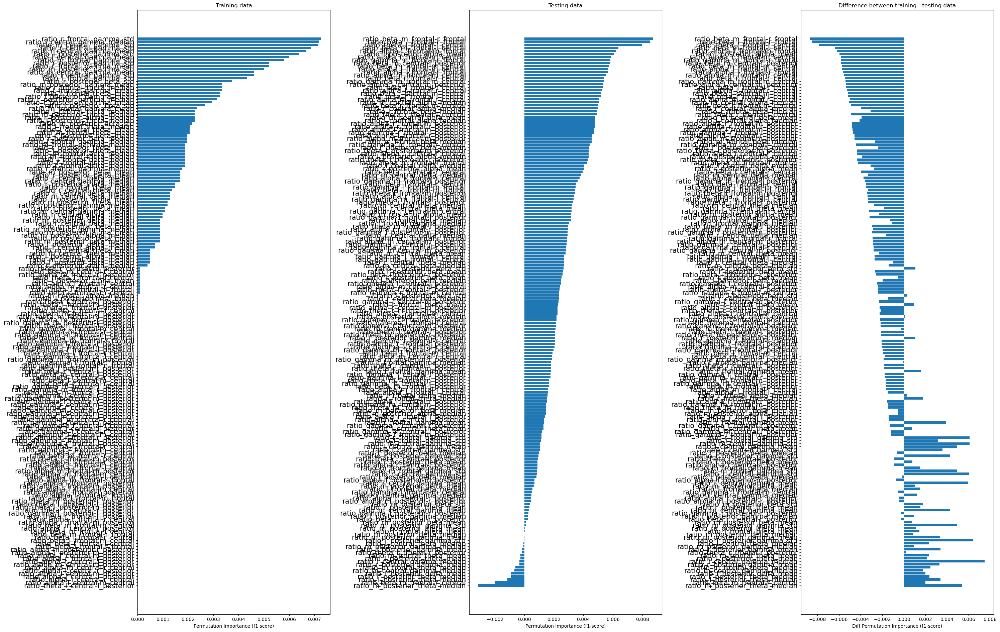

In [60]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')
ax1.tick_params(axis='y', labelsize=15)  # Adjust font size

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')
ax2.tick_params(axis='y', labelsize=15)  # Adjust font size

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')
ax3.tick_params(axis='y', labelsize=15)  # Adjust font size

plt.subplots_adjust(wspace=0.5)  # Increase the width space between subplots
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the layout to fit everything nicely
plt.show()

#### EC feature set

In [61]:
from sklearn import svm
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.svm import SVC
from sklearn.multiclass import OneVsRestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_conn_features_ec['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_conn_features_ec.columns if 'EC' in num_col]
 
X = df_stat_conn_features_ec[numeric_cols]
Y = df_stat_conn_features_ec['diagnosis']
# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# hyperparameter ranges for GridSearch
param_grid = {
'rbf_svm__estimator__C': [0.01, 0.1, 1, 10, 100],
'rbf_svm__estimator__gamma': [0.1, 1, 10, 100],
'rbf_svm__estimator__kernel': ['rbf'],
'rbf_svm__estimator__class_weight': ['balanced']
}

# final pipeline
steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(class_weight = 'balanced')))]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

# define gridsearch
gridsearch = GridSearchCV(pipeline,
                        param_grid = param_grid,
                        cv = cv_inner, # use inner cv for hyperparameter tuning
                        scoring = f1_scorer,
                        error_score = 'raise',
                        return_train_score = True,
                        n_jobs=-1,
                        verbose=1)

# nested CV with parameter optimization to compute testing score (f1-score)
nested_cv_gridsearch = cross_validate(gridsearch,
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 return_estimator=True,
                                 return_train_score = False,
                                 verbose=1,
                                 n_jobs=-1)
print('SVM test scores:', nested_cv_gridsearch['test_score'])
print('Mean SVM test score:', np.mean(nested_cv_gridsearch['test_score']))
print('STD SVM test score:', np.std(nested_cv_gridsearch['test_score']))

# obtain best model during nested CV
best_score_index = np.argmax(nested_cv_gridsearch['test_score'])
best_model = nested_cv_gridsearch['estimator'][best_score_index]
print('Parameters of the best model:', best_model.best_params_)


# of instances: 2700
(2700, 5)


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
SVM test scores: [0.12152663 0.06563467 0.08199706 0.09934066 0.08892857]
Mean SVM test score: 0.09148551941004968
STD SVM test score: 0.01859573326442503
Parameters of the best model: {'rbf_svm__estimator__C': 0.01, 'rbf_svm__estimator__class_weight': 'balanced', 'rbf_svm__estimator__gamma': 0.1, 'rbf_svm__estimator__kernel': 'rbf'}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  1.2min finished


In [62]:
# save the nested CV
joblib.dump(nested_cv_gridsearch, 'nested_cv_statconn_svm_ec.pkl', compress=3)

['nested_cv_statconn_svm_ec.pkl']

{'C': 0.01, 'class_weight': 'balanced', 'gamma': 0.1, 'kernel': 'rbf'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   19.2s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


f1_score: 0.12200376488069938

classification report:
               precision    recall  f1-score   support

        ADHD       0.57      0.02      0.04       540
     HEALTHY       0.20      0.20      0.20       540
         MDD       0.53      0.01      0.03       540
         OCD       0.31      0.01      0.01       540
         SMC       0.20      0.80      0.33       540

    accuracy                           0.21      2700
   macro avg       0.36      0.21      0.12      2700
weighted avg       0.36      0.21      0.12      2700



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   18.9s finished


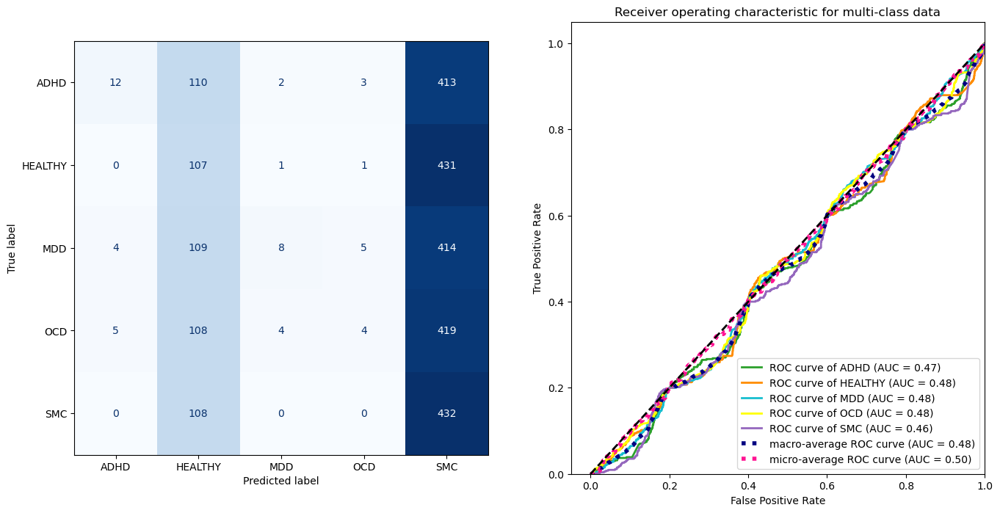

In [63]:
# final pipeline
best_params = {}
for hyperparameter in best_model.best_params_:
    key = hyperparameter[20:]
    best_params[key] = best_model.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(**best_params, probability=True)))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

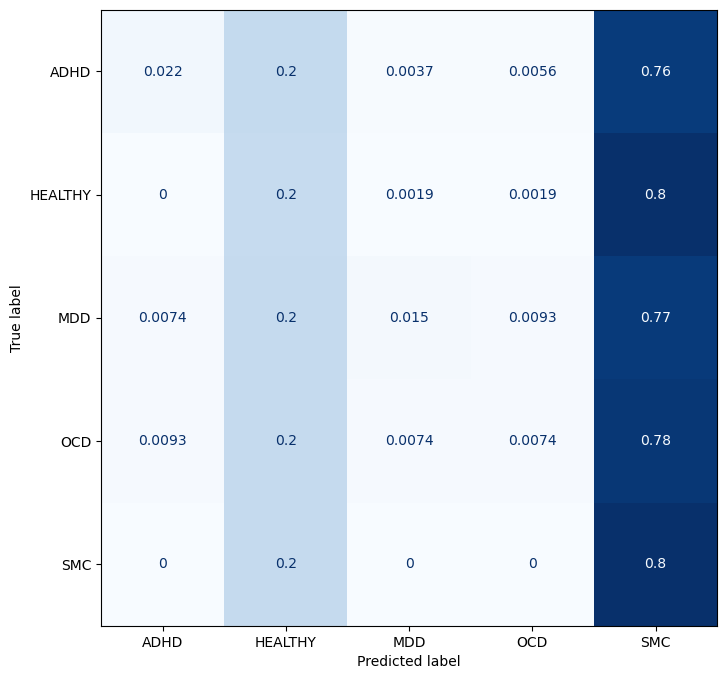

In [64]:
# print the confusion matrix normalized by true labels
fig, ax = plt.subplots(figsize=(8,8))
conf_matrix = confusion_matrix(Y, Y_pred, normalize='true')
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', colorbar=False, ax=ax)

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 319), X_test.shape = (672, 319), Y_train.shape = (2028,), Y_test.shape = (672,)


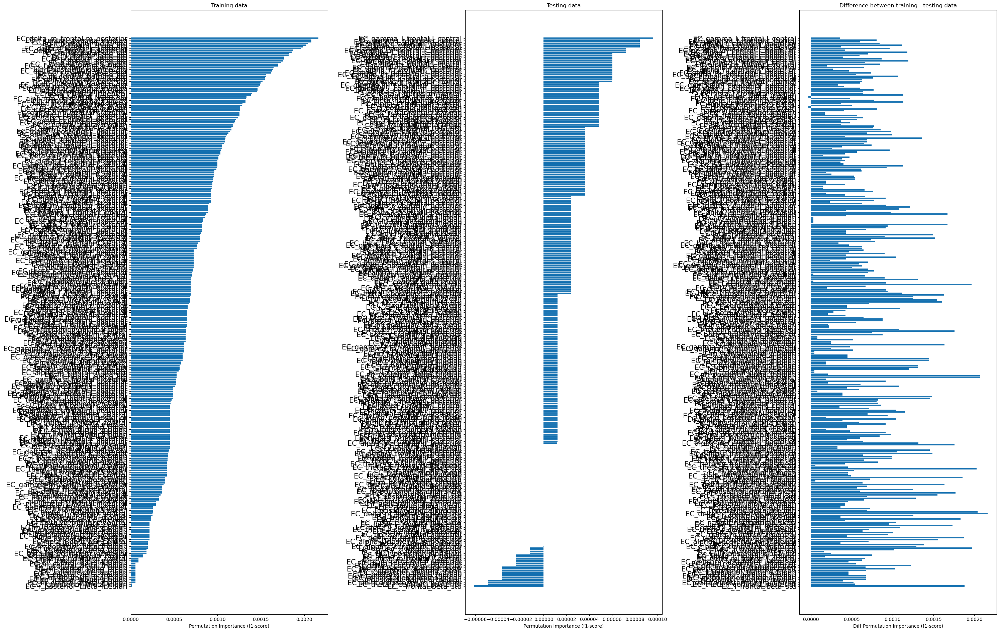

In [65]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')
ax1.tick_params(axis='y', labelsize=15)  # Adjust font size

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')
ax2.tick_params(axis='y', labelsize=15)  # Adjust font size

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')
ax3.tick_params(axis='y', labelsize=15)  # Adjust font size

plt.subplots_adjust(wspace=0.5)  # Increase the width space between subplots
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the layout to fit everything nicely
plt.show()

#### EO feature set

In [66]:
from sklearn import svm
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.svm import SVC
from sklearn.multiclass import OneVsRestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_conn_features_eo['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_conn_features_eo.columns if 'EO' in num_col]
 
X = df_stat_conn_features_eo[numeric_cols]
Y = df_stat_conn_features_eo['diagnosis']
# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# hyperparameter ranges for GridSearch
param_grid = {
'rbf_svm__estimator__C': [0.01, 0.1, 1, 10, 100],
'rbf_svm__estimator__gamma': [0.1, 1, 10, 100],
'rbf_svm__estimator__kernel': ['rbf'],
'rbf_svm__estimator__class_weight': ['balanced']
}

# final pipeline
steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(class_weight = 'balanced')))]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

# define gridsearch
gridsearch = GridSearchCV(pipeline,
                        param_grid = param_grid,
                        cv = cv_inner, # use inner cv for hyperparameter tuning
                        scoring = f1_scorer,
                        error_score = 'raise',
                        return_train_score = True,
                        n_jobs=-1,
                        verbose=1)

# nested CV with parameter optimization to compute testing score (f1-score)
nested_cv_gridsearch = cross_validate(gridsearch,
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 return_estimator=True,
                                 return_train_score = False,
                                 verbose=1,
                                 n_jobs=-1)
print('SVM test scores:', nested_cv_gridsearch['test_score'])
print('Mean SVM test score:', np.mean(nested_cv_gridsearch['test_score']))
print('STD SVM test score:', np.std(nested_cv_gridsearch['test_score']))

# obtain best model during nested CV
best_score_index = np.argmax(nested_cv_gridsearch['test_score'])
best_model = nested_cv_gridsearch['estimator'][best_score_index]
print('Parameters of the best model:', best_model.best_params_)

# of instances: 2700
(2700, 5)


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
SVM test scores: [0.17970884 0.12733794 0.08235029 0.16327151 0.15185886]
Mean SVM test score: 0.14090548740216033
STD SVM test score: 0.033878325127674656
Parameters of the best model: {'rbf_svm__estimator__C': 0.01, 'rbf_svm__estimator__class_weight': 'balanced', 'rbf_svm__estimator__gamma': 0.1, 'rbf_svm__estimator__kernel': 'rbf'}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  1.1min finished


In [67]:
# save the nested CV
joblib.dump(nested_cv_gridsearch, 'nested_cv_statconn_svm_eo.pkl', compress=3)

Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits


['nested_cv_statconn_svm_eo.pkl']

{'C': 0.01, 'class_weight': 'balanced', 'gamma': 0.1, 'kernel': 'rbf'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   18.4s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


f1_score: 0.15915532487297082

classification report:
               precision    recall  f1-score   support

        ADHD       0.35      0.18      0.24       540
     HEALTHY       0.11      0.02      0.03       540
         MDD       0.09      0.01      0.02       540
         OCD       0.49      0.08      0.13       540
         SMC       0.23      0.94      0.37       540

    accuracy                           0.25      2700
   macro avg       0.25      0.25      0.16      2700
weighted avg       0.25      0.25      0.16      2700



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   18.1s finished


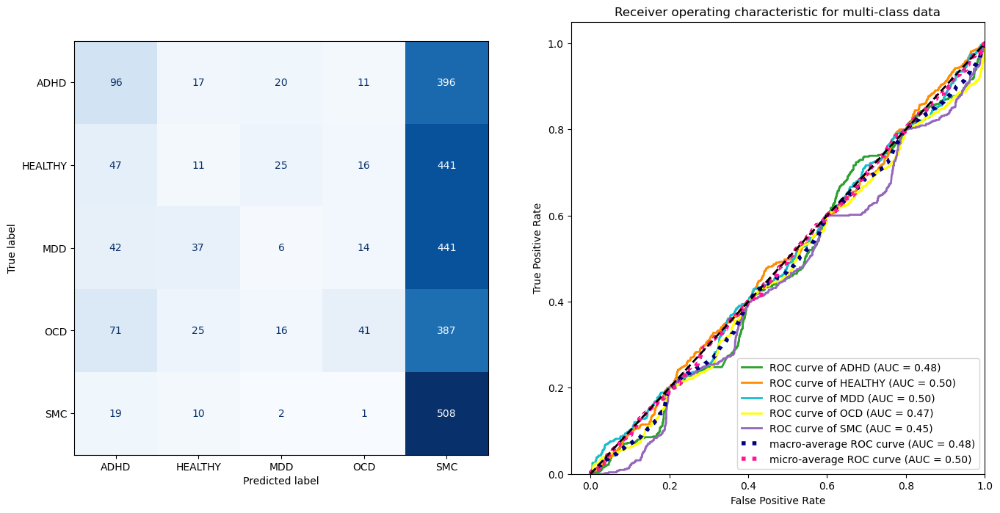

In [68]:
# final pipeline
best_params = {}
for hyperparameter in best_model.best_params_:
    key = hyperparameter[20:]
    best_params[key] = best_model.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(**best_params, probability=True)))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

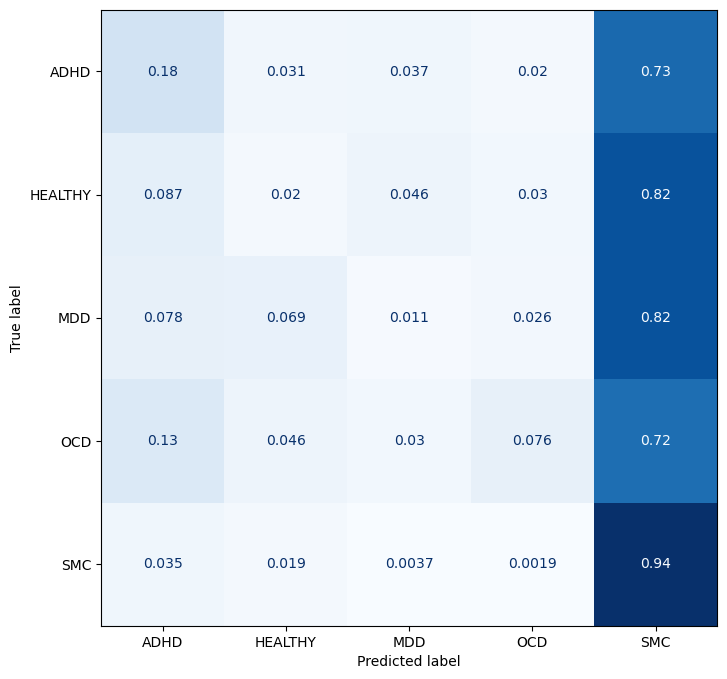

In [69]:
# print the confusion matrix normalized by true labels
fig, ax = plt.subplots(figsize=(8,8))
conf_matrix = confusion_matrix(Y, Y_pred, normalize='true')
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', colorbar=False, ax=ax)

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 301), X_test.shape = (672, 301), Y_train.shape = (2028,), Y_test.shape = (672,)


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


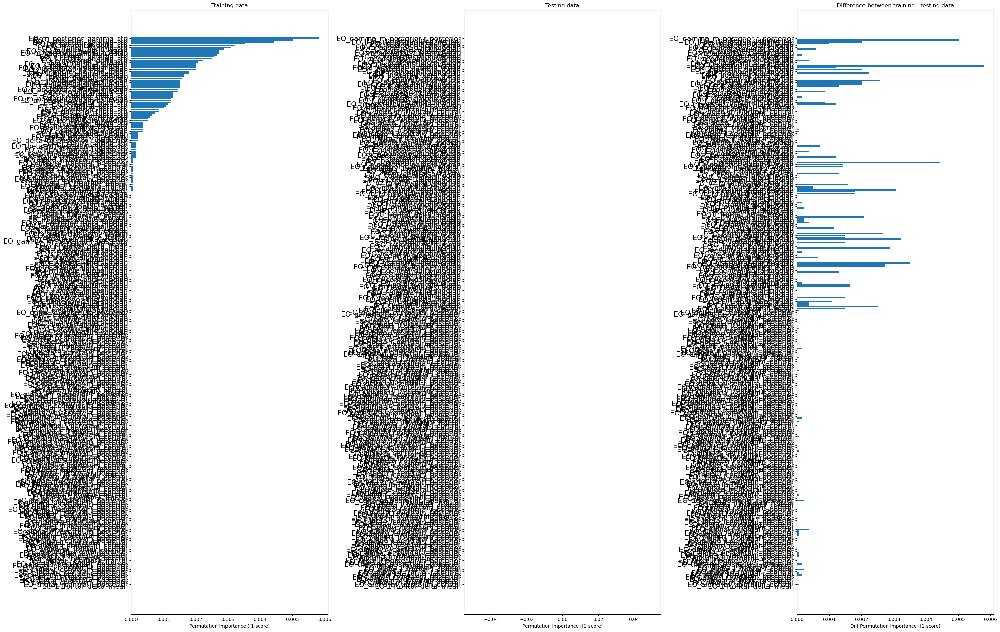

In [70]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')
ax1.tick_params(axis='y', labelsize=15)  # Adjust font size

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')
ax2.tick_params(axis='y', labelsize=15)  # Adjust font size

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')
ax3.tick_params(axis='y', labelsize=15)  # Adjust font size

plt.subplots_adjust(wspace=0.5)  # Increase the width space between subplots
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the layout to fit everything nicely
plt.show()

## Random Forest

#### ratio feature set

In [71]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import RandomForestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_conn_features_ratio['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_conn_features_ratio.columns if 'ratio' in num_col]
 
X = df_stat_conn_features_ratio[numeric_cols]
Y = df_stat_conn_features_ratio['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# final pipeline
steps = [('col_trans', col_trans), ('RF', RandomForestClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
max_features = ['log2', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'RF__n_estimators': n_estimators,
               'RF__max_features': max_features,
               'RF__max_depth': max_depth,
               'RF__min_samples_split': min_samples_split,
               'RF__min_samples_leaf': min_samples_leaf,
               'RF__bootstrap': bootstrap}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# nested CV with parameter optimization to compute testing score (f1-score)
nested_cv_randsearch = cross_validate(randsearch,
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 return_estimator=True,
                                 return_train_score = False,
                                 verbose=1,
                                 n_jobs=-1)
print('RF test scores:', nested_cv_randsearch['test_score'])
print('Mean RF test score:', np.mean(nested_cv_randsearch['test_score']))
print('STD RF test score:', np.std(nested_cv_randsearch['test_score']))

# obtain best model during nested CV
best_score_index = np.argmax(nested_cv_randsearch['test_score'])
best_model = nested_cv_randsearch['estimator'][best_score_index]
print('Parameters of the best model:', best_model.best_params_)


# of instances: 2700
(2700, 5)


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
RF test scores: [0.36568744 0.36234893 0.27815755 0.25708039 0.28554936]
Mean RF test score: 0.3097647335506656
STD RF test score: 0.04528462310095588
Parameters of the best model: {'RF__n_estimators': 1200, 'RF__min_samples_split': 5, 'RF__min_samples_leaf': 1, 'RF__max_features': 'log2', 'RF__max_depth': 80, 'RF__bootstrap': True}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 30.8min finished


In [72]:
# save the nested CV
joblib.dump(nested_cv_randsearch, 'nested_cv_statconn_rf_ratio.pkl', compress=3)

['nested_cv_statconn_rf_ratio.pkl']

{'n_estimators': 1200, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 'log2', 'max_depth': 80, 'bootstrap': True}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   18.6s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


f1_score: 0.30735928935159784

classification report:
               precision    recall  f1-score   support

        ADHD       0.42      0.44      0.43       540
     HEALTHY       0.32      0.33      0.32       540
         MDD       0.23      0.20      0.21       540
         OCD       0.26      0.24      0.25       540
         SMC       0.31      0.35      0.33       540

    accuracy                           0.31      2700
   macro avg       0.31      0.31      0.31      2700
weighted avg       0.31      0.31      0.31      2700



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   17.6s finished


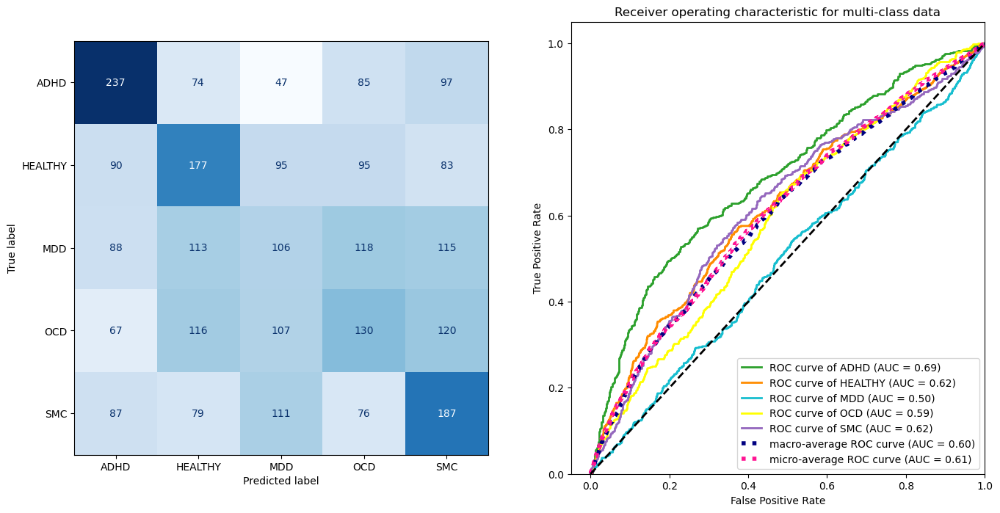

In [73]:
# final pipeline
best_params = {}
for hyperparameter in best_model.best_params_:
    key = hyperparameter[4:]
    best_params[key] = best_model.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('RF', RandomForestClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

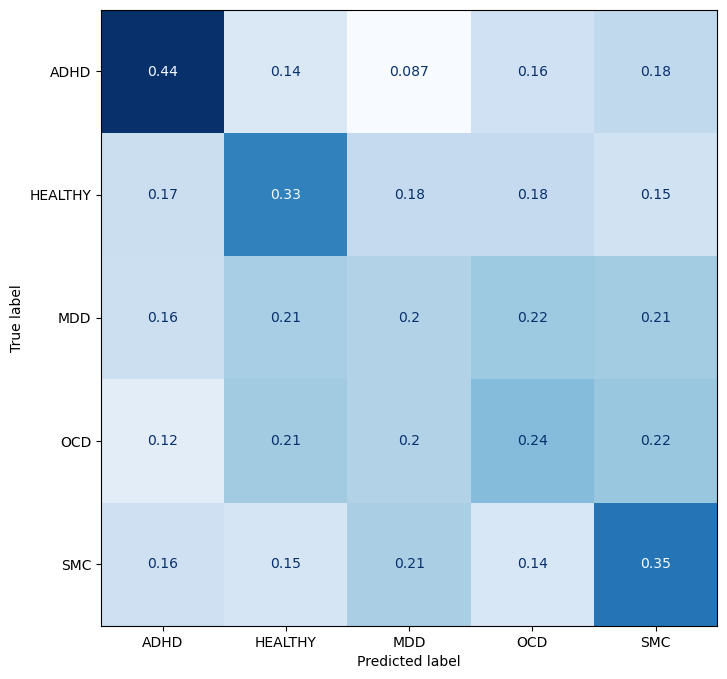

In [74]:
# print the confusion matrix normalized by true labels
fig, ax = plt.subplots(figsize=(8,8))
conf_matrix = confusion_matrix(Y, Y_pred, normalize='true')
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', colorbar=False, ax=ax)

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 182), X_test.shape = (672, 182), Y_train.shape = (2028,), Y_test.shape = (672,)


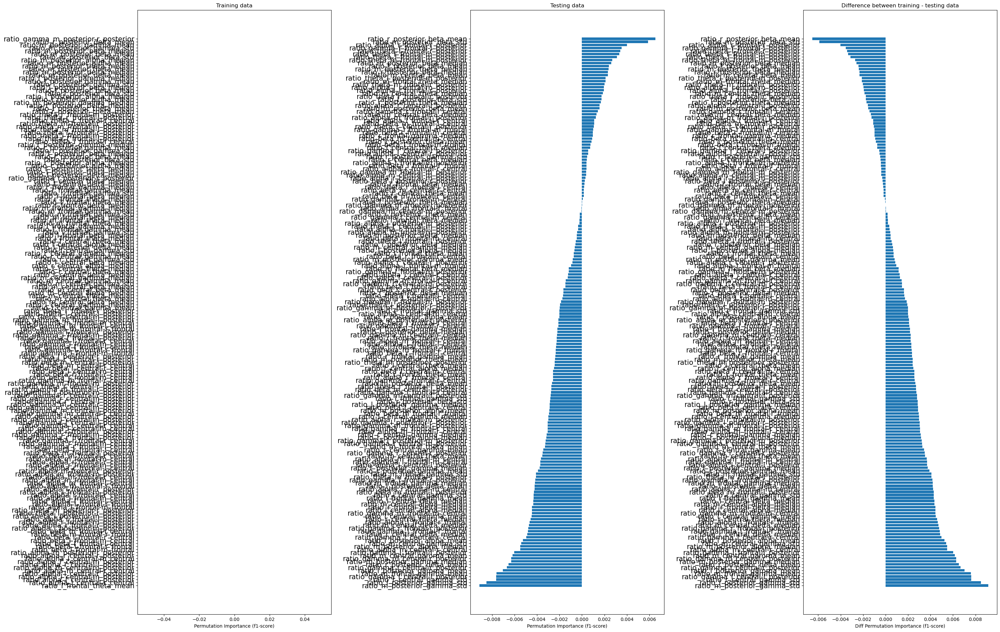

In [75]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')
ax1.tick_params(axis='y', labelsize=15)  # Adjust font size

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')
ax2.tick_params(axis='y', labelsize=15)  # Adjust font size

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')
ax3.tick_params(axis='y', labelsize=15)  # Adjust font size

plt.subplots_adjust(wspace=0.5)  # Increase the width space between subplots
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the layout to fit everything nicely
plt.show()

#### EC feature set

In [76]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import RandomForestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_conn_features_ec['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_conn_features_ec.columns if 'EC' in num_col]
 
X = df_stat_conn_features_ec[numeric_cols]
Y = df_stat_conn_features_ec['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# final pipeline
steps = [('col_trans', col_trans), ('RF', RandomForestClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
max_features = ['log2', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'RF__n_estimators': n_estimators,
               'RF__max_features': max_features,
               'RF__max_depth': max_depth,
               'RF__min_samples_split': min_samples_split,
               'RF__min_samples_leaf': min_samples_leaf,
               'RF__bootstrap': bootstrap}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# nested CV with parameter optimization to compute testing score (f1-score)
nested_cv_randsearch = cross_validate(randsearch,
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 return_estimator=True,
                                 return_train_score = False,
                                 verbose=1,
                                 n_jobs=-1)
print('RF test scores:', nested_cv_randsearch['test_score'])
print('Mean RF test score:', np.mean(nested_cv_randsearch['test_score']))
print('STD RF test score:', np.std(nested_cv_randsearch['test_score']))

# obtain best model during nested CV
best_score_index = np.argmax(nested_cv_randsearch['test_score'])
best_model = nested_cv_randsearch['estimator'][best_score_index]
print('Parameters of the best model:', best_model.best_params_)


# of instances: 2700
(2700, 5)


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
RF test scores: [0.40822468 0.47049184 0.38360111 0.37666872 0.41273277]
Mean RF test score: 0.41034382518755796
STD RF test score: 0.03309733387866415
Parameters of the best model: {'RF__n_estimators': 1200, 'RF__min_samples_split': 2, 'RF__min_samples_leaf': 2, 'RF__max_features': 'log2', 'RF__max_depth': 70, 'RF__bootstrap': True}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 32.2min finished


In [77]:
# save the nested CV
joblib.dump(nested_cv_randsearch, 'nested_cv_statconn_rf_ec.pkl', compress=3)

['nested_cv_statconn_rf_ec.pkl']

{'n_estimators': 1200, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_features': 'log2', 'max_depth': 70, 'bootstrap': True}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   17.6s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


f1_score: 0.4191377948877739

classification report:
               precision    recall  f1-score   support

        ADHD       0.49      0.49      0.49       540
     HEALTHY       0.45      0.50      0.47       540
         MDD       0.37      0.33      0.35       540
         OCD       0.36      0.34      0.35       540
         SMC       0.42      0.45      0.44       540

    accuracy                           0.42      2700
   macro avg       0.42      0.42      0.42      2700
weighted avg       0.42      0.42      0.42      2700



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   16.6s finished


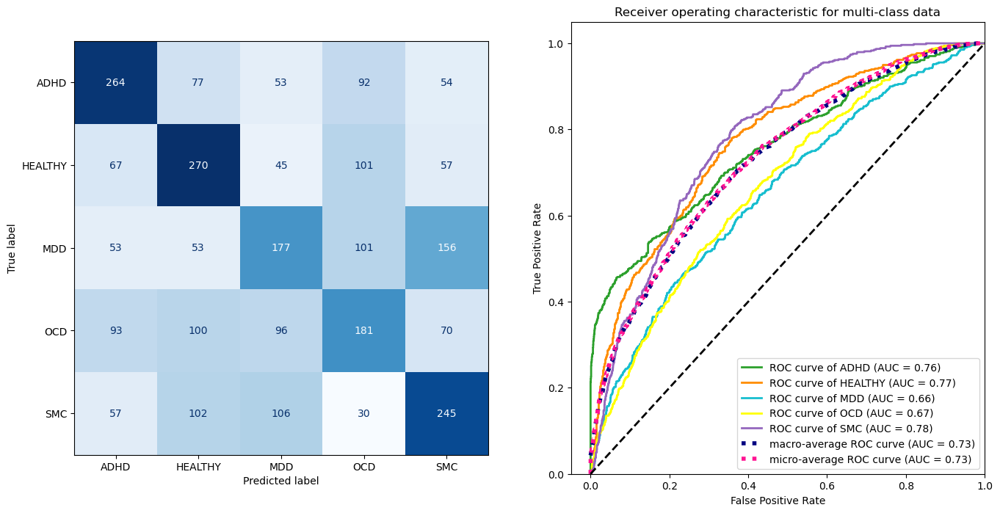

In [78]:
# final pipeline
best_params = {}
for hyperparameter in best_model.best_params_:
    key = hyperparameter[4:]
    best_params[key] = best_model.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('RF', RandomForestClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

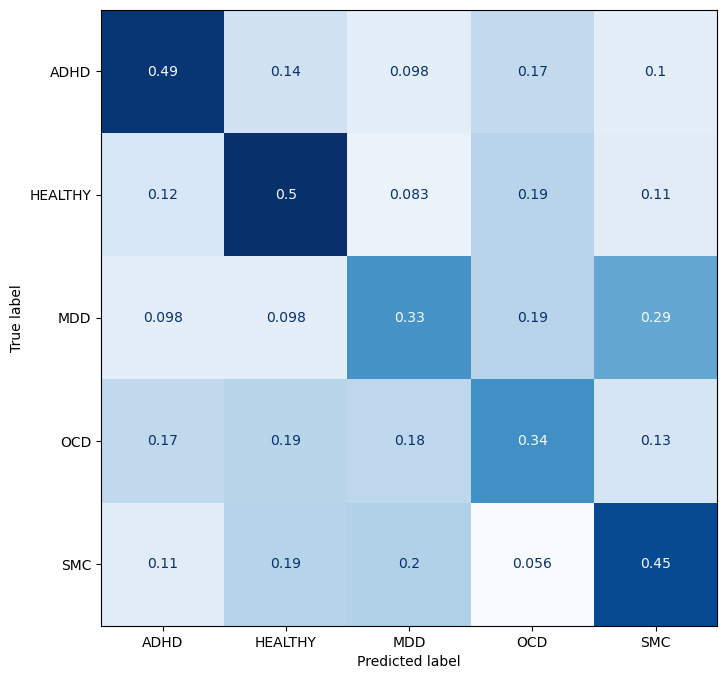

In [79]:
# print the confusion matrix normalized by true labels
fig, ax = plt.subplots(figsize=(8,8))
conf_matrix = confusion_matrix(Y, Y_pred, normalize='true')
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', colorbar=False, ax=ax)

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 319), X_test.shape = (672, 319), Y_train.shape = (2028,), Y_test.shape = (672,)


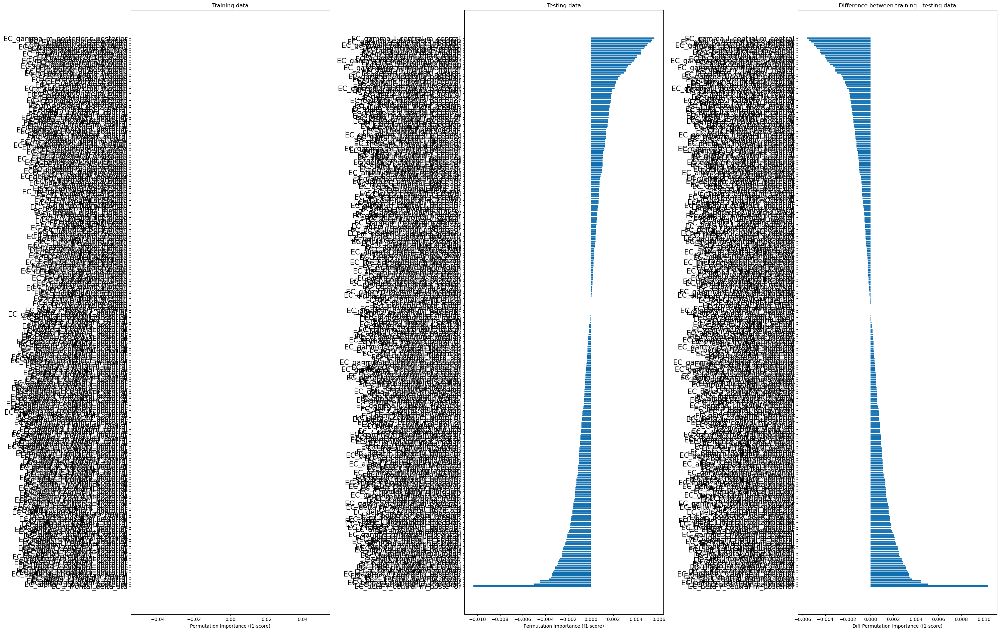

In [80]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')
ax1.tick_params(axis='y', labelsize=15)  # Adjust font size

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')
ax2.tick_params(axis='y', labelsize=15)  # Adjust font size

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')
ax3.tick_params(axis='y', labelsize=15)  # Adjust font size

plt.subplots_adjust(wspace=0.5)  # Increase the width space between subplots
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the layout to fit everything nicely
plt.show()

#### EO feature set

In [81]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import RandomForestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_conn_features_eo['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_conn_features_eo.columns if 'EO' in num_col]

X = df_stat_conn_features_eo[numeric_cols]
Y = df_stat_conn_features_eo['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# final pipeline
steps = [('col_trans', col_trans), ('RF', RandomForestClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
max_features = ['log2', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'RF__n_estimators': n_estimators,
               'RF__max_features': max_features,
               'RF__max_depth': max_depth,
               'RF__min_samples_split': min_samples_split,
               'RF__min_samples_leaf': min_samples_leaf,
               'RF__bootstrap': bootstrap}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# nested CV with parameter optimization to compute testing score (f1-score)
nested_cv_randsearch = cross_validate(randsearch,
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 return_estimator=True,
                                 return_train_score = False,
                                 verbose=1,
                                 n_jobs=-1)
print('RF test scores:', nested_cv_randsearch['test_score'])
print('Mean RF test score:', np.mean(nested_cv_randsearch['test_score']))
print('STD RF test score:', np.std(nested_cv_randsearch['test_score']))

# obtain best model during nested CV
best_score_index = np.argmax(nested_cv_randsearch['test_score'])
best_model = nested_cv_randsearch['estimator'][best_score_index]
print('Parameters of the best model:', best_model.best_params_)

# of instances: 2700
(2700, 5)


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
RF test scores: [0.4255424  0.46269416 0.3403867  0.33467768 0.41648275]
Mean RF test score: 0.39595673909959855
STD RF test score: 0.0501869773356693
Parameters of the best model: {'RF__n_estimators': 2000, 'RF__min_samples_split': 10, 'RF__min_samples_leaf': 2, 'RF__max_features': 'log2', 'RF__max_depth': 30, 'RF__bootstrap': True}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 32.3min finished


In [82]:
# save the nested CV
joblib.dump(nested_cv_randsearch, 'nested_cv_statconn_rf_eo.pkl', compress=3)

['nested_cv_statconn_rf_eo.pkl']

{'n_estimators': 2000, 'min_samples_split': 10, 'min_samples_leaf': 2, 'max_features': 'log2', 'max_depth': 30, 'bootstrap': True}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   27.8s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


f1_score: 0.40277376893195566

classification report:
               precision    recall  f1-score   support

        ADHD       0.52      0.49      0.50       540
     HEALTHY       0.34      0.44      0.38       540
         MDD       0.24      0.19      0.21       540
         OCD       0.43      0.36      0.39       540
         SMC       0.49      0.56      0.52       540

    accuracy                           0.41      2700
   macro avg       0.40      0.41      0.40      2700
weighted avg       0.40      0.41      0.40      2700



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   26.6s finished


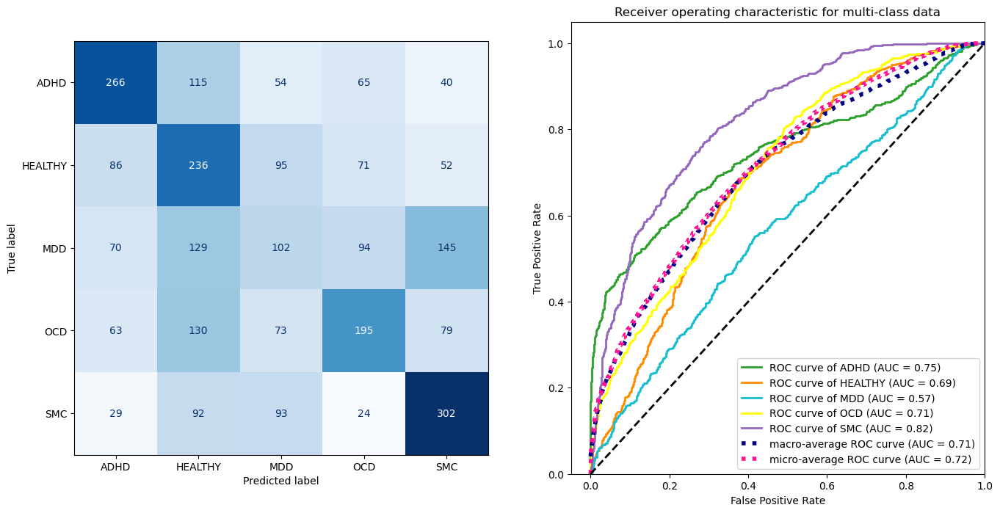

In [83]:
# final pipeline
best_params = {}
for hyperparameter in best_model.best_params_:
    key = hyperparameter[4:]
    best_params[key] = best_model.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('RF', RandomForestClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

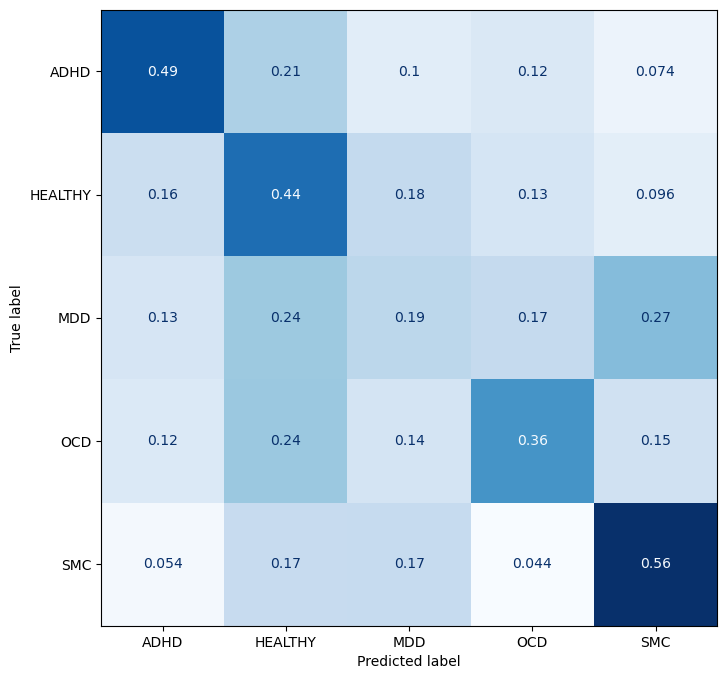

In [84]:
# print the confusion matrix normalized by true labels
fig, ax = plt.subplots(figsize=(8,8))
conf_matrix = confusion_matrix(Y, Y_pred, normalize='true')
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', colorbar=False, ax=ax)

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 301), X_test.shape = (672, 301), Y_train.shape = (2028,), Y_test.shape = (672,)


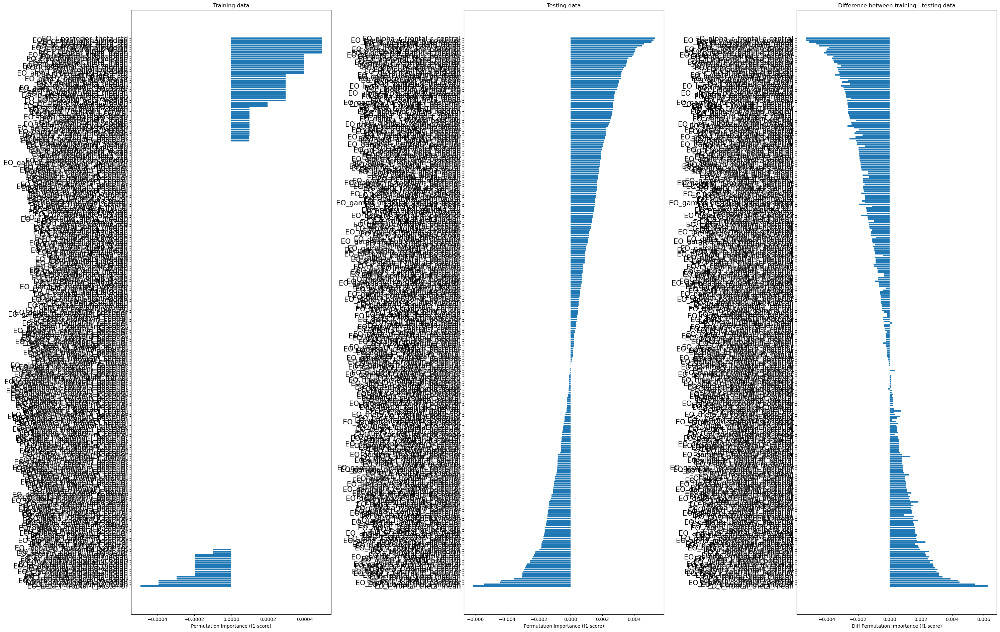

In [85]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')
ax1.tick_params(axis='y', labelsize=15)  # Adjust font size

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')
ax2.tick_params(axis='y', labelsize=15)  # Adjust font size

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')
ax3.tick_params(axis='y', labelsize=15)  # Adjust font size

plt.subplots_adjust(wspace=0.5)  # Increase the width space between subplots
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the layout to fit everything nicely
plt.show()

## GradientBoostingClassifier

#### ratio feature set

In [86]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import GradientBoostingClassifier
from scipy.stats import loguniform


# assign groups (IDs) for GroupKFold
groups = df_stat_conn_features_ratio['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_conn_features_ratio.columns if 'ratio' in num_col]
 
X = df_stat_conn_features_ratio[numeric_cols]
Y = df_stat_conn_features_ratio['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)


# final pipeline
steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of boosting stages to perform
n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1000, num = 10)]
# Loss function to be optimized
loss = ['log_loss']
# Learning rate
learning_rate = loguniform.rvs(0.001, 0.1, size=1000)
# Fraction of samples to be used for fitting the individual base learners
subsample = [x for x in np.linspace(0.5, 1, 5)]
# The function to measure the quality of the split
criterion = ['friedman_mse']
# The min number of samples required to split an internal node
min_samples_split = [2, 5, 10]
# Create the random grid
random_grid = {'gbc__n_estimators': n_estimators,
               'gbc__loss': loss,
               'gbc__learning_rate': learning_rate,
               'gbc__subsample': subsample,
               'gbc__criterion': criterion,
               'gbc__min_samples_split': min_samples_split}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# nested CV with parameter optimization to compute testing score (f1-score)
nested_cv_randsearch = cross_validate(randsearch,
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 return_estimator=True,
                                 return_train_score = False,
                                 verbose=1,
                                 n_jobs=-1)
print('GBC test scores:', nested_cv_randsearch['test_score'])
print('Mean GBC test score:', np.mean(nested_cv_randsearch['test_score']))
print('STD GBC test score:', np.std(nested_cv_randsearch['test_score']))

# obtain best model during nested CV
best_score_index = np.argmax(nested_cv_randsearch['test_score'])
best_model = nested_cv_randsearch['estimator'][best_score_index]
print('Parameters of the best model:', best_model.best_params_)

# of instances: 2700
(2700, 5)


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
GBC test scores: [0.347696   0.34870859 0.29495638 0.22364507 0.33789738]
Mean GBC test score: 0.3105806847026364
STD GBC test score: 0.04770619781773447
Parameters of the best model: {'gbc__subsample': 0.75, 'gbc__n_estimators': 1000, 'gbc__min_samples_split': 10, 'gbc__loss': 'log_loss', 'gbc__learning_rate': 0.0255077211696248, 'gbc__criterion': 'friedman_mse'}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 166.9min finished


In [87]:
# save the nested CV
joblib.dump(nested_cv_randsearch, 'nested_cv_statconn_gbc_ratio.pkl', compress=3)

['nested_cv_statconn_gbc_ratio.pkl']

{'subsample': 0.75, 'n_estimators': 1000, 'min_samples_split': 10, 'loss': 'log_loss', 'learning_rate': 0.0255077211696248, 'criterion': 'friedman_mse'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  8.3min finished


f1_score: 0.3183925549827275

classification report:
               precision    recall  f1-score   support

        ADHD       0.39      0.40      0.39       540
     HEALTHY       0.30      0.30      0.30       540
         MDD       0.25      0.27      0.26       540
         OCD       0.31      0.30      0.30       540
         SMC       0.35      0.34      0.34       540

    accuracy                           0.32      2700
   macro avg       0.32      0.32      0.32      2700
weighted avg       0.32      0.32      0.32      2700



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  8.3min finished


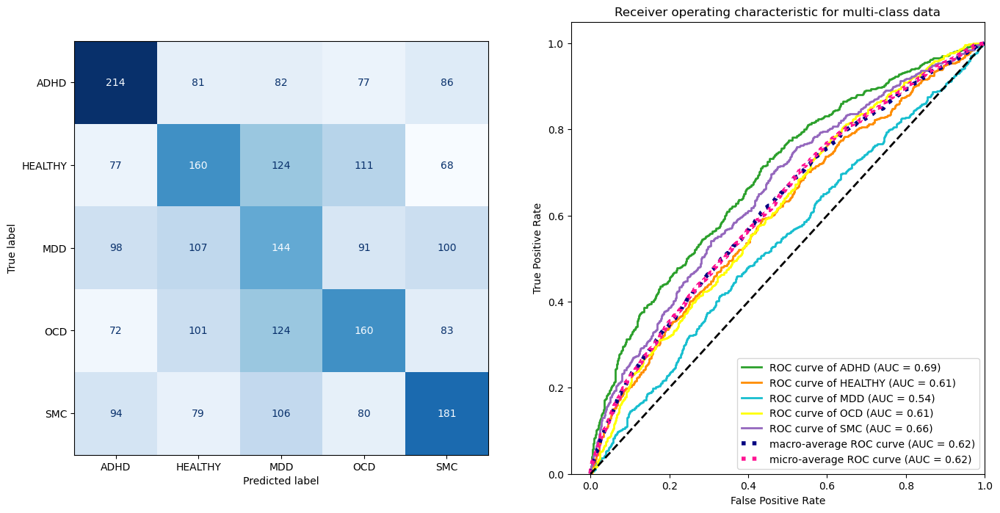

In [88]:
# final pipeline
best_params = {}
for hyperparameter in best_model.best_params_:
    key = hyperparameter[5:]
    best_params[key] = best_model.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

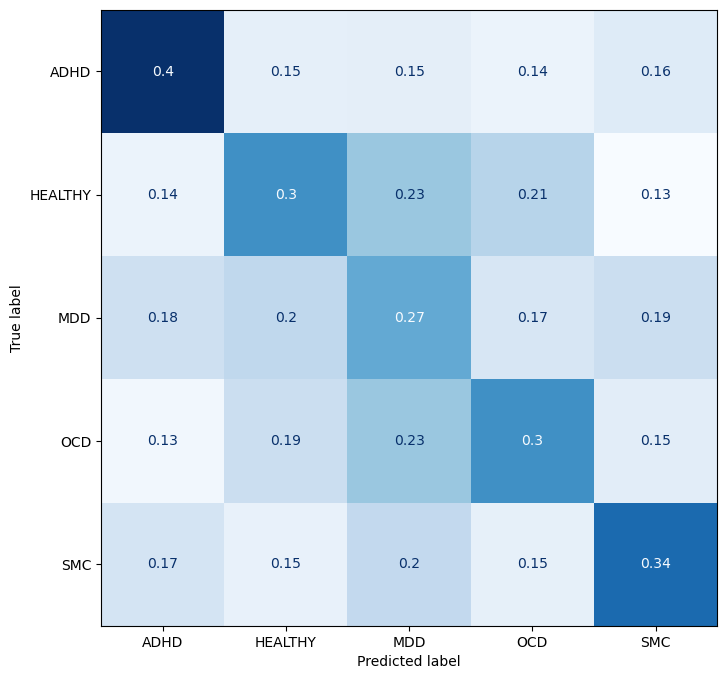

In [89]:
# print the confusion matrix normalized by true labels
fig, ax = plt.subplots(figsize=(8,8))
conf_matrix = confusion_matrix(Y, Y_pred, normalize='true')
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', colorbar=False, ax=ax)

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 182), X_test.shape = (672, 182), Y_train.shape = (2028,), Y_test.shape = (672,)


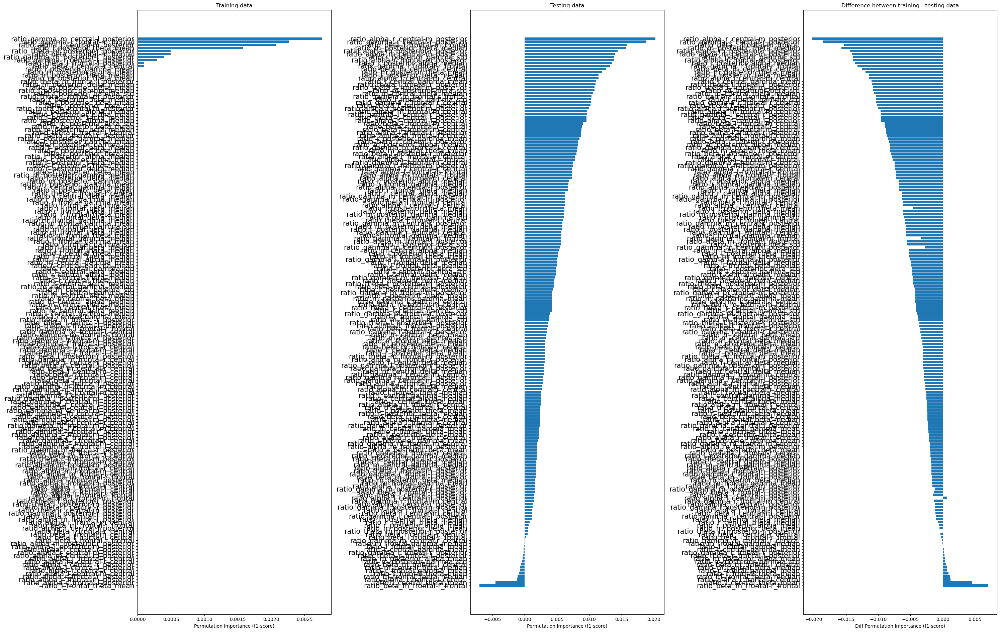

In [90]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')
ax1.tick_params(axis='y', labelsize=15)  # Adjust font size

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')
ax2.tick_params(axis='y', labelsize=15)  # Adjust font size

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')
ax3.tick_params(axis='y', labelsize=15)  # Adjust font size

plt.subplots_adjust(wspace=0.5)  # Increase the width space between subplots
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the layout to fit everything nicely
plt.show()

#### EC feature set

In [91]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import GradientBoostingClassifier
from scipy.stats import loguniform


# assign groups (IDs) for GroupKFold
groups = df_stat_conn_features_ec['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_conn_features_ec.columns if 'EC' in num_col]
 
X = df_stat_conn_features_ec[numeric_cols]
Y = df_stat_conn_features_ec['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)


# final pipeline
steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of boosting stages to perform
n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1000, num = 10)]
# Loss function to be optimized
loss = ['log_loss']
# Learning rate
learning_rate = loguniform.rvs(0.001, 0.1, size=1000)
# Fraction of samples to be used for fitting the individual base learners
subsample = [x for x in np.linspace(0.5, 1, 5)]
# The function to measure the quality of the split
criterion = ['friedman_mse']
# The min number of samples required to split an internal node
min_samples_split = [2, 5, 10]
# Create the random grid
random_grid = {'gbc__n_estimators': n_estimators,
               'gbc__loss': loss,
               'gbc__learning_rate': learning_rate,
               'gbc__subsample': subsample,
               'gbc__criterion': criterion,
               'gbc__min_samples_split': min_samples_split}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# nested CV with parameter optimization to compute testing score (f1-score)
nested_cv_randsearch = cross_validate(randsearch,
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 return_estimator=True,
                                 return_train_score = False,
                                 verbose=1,
                                 n_jobs=-1)
print('GBC test scores:', nested_cv_randsearch['test_score'])
print('Mean GBC test score:', np.mean(nested_cv_randsearch['test_score']))
print('STD GBC test score:', np.std(nested_cv_randsearch['test_score']))

# obtain best model during nested CV
best_score_index = np.argmax(nested_cv_randsearch['test_score'])
best_model = nested_cv_randsearch['estimator'][best_score_index]
print('Parameters of the best model:', best_model.best_params_)

# of instances: 2700
(2700, 5)


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
GBC test scores: [0.48527179 0.50531711 0.38619509 0.38034995 0.47521558]
Mean GBC test score: 0.4464699020210574
STD GBC test score: 0.052535312649707316
Parameters of the best model: {'gbc__subsample': 0.5, 'gbc__n_estimators': 700, 'gbc__min_samples_split': 10, 'gbc__loss': 'log_loss', 'gbc__learning_rate': 0.022013224311665046, 'gbc__criterion': 'friedman_mse'}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 278.4min finished


In [92]:
# save the nested CV
joblib.dump(nested_cv_randsearch, 'nested_cv_statconn_gbc_ec.pkl', compress=3)

['nested_cv_statconn_gbc_ec.pkl']

{'subsample': 0.5, 'n_estimators': 700, 'min_samples_split': 10, 'loss': 'log_loss', 'learning_rate': 0.022013224311665046, 'criterion': 'friedman_mse'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  6.6min finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


f1_score: 0.44247581218072063

classification report:
               precision    recall  f1-score   support

        ADHD       0.52      0.56      0.54       540
     HEALTHY       0.42      0.42      0.42       540
         MDD       0.35      0.34      0.34       540
         OCD       0.39      0.37      0.38       540
         SMC       0.52      0.54      0.53       540

    accuracy                           0.44      2700
   macro avg       0.44      0.44      0.44      2700
weighted avg       0.44      0.44      0.44      2700



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  6.6min finished


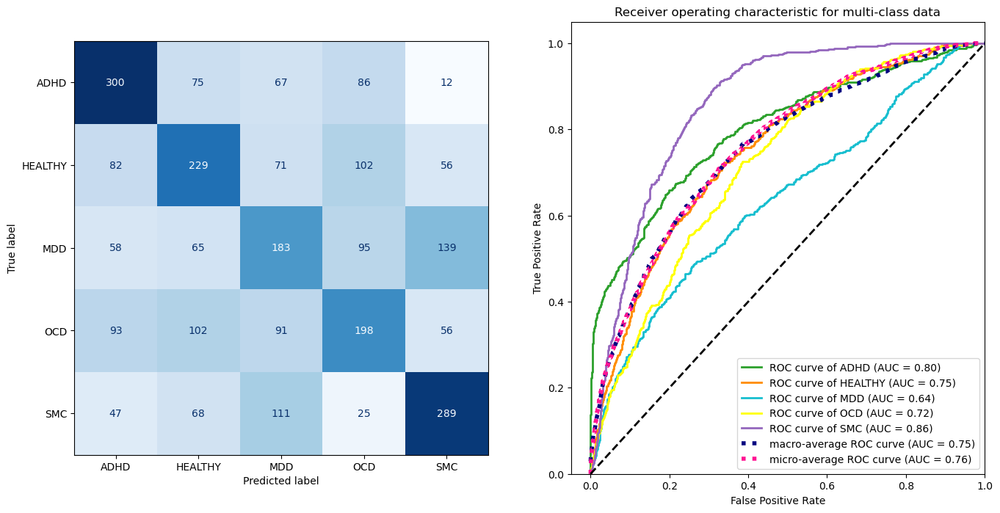

In [93]:
# final pipeline
best_params = {}
for hyperparameter in best_model.best_params_:
    key = hyperparameter[5:]
    best_params[key] = best_model.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

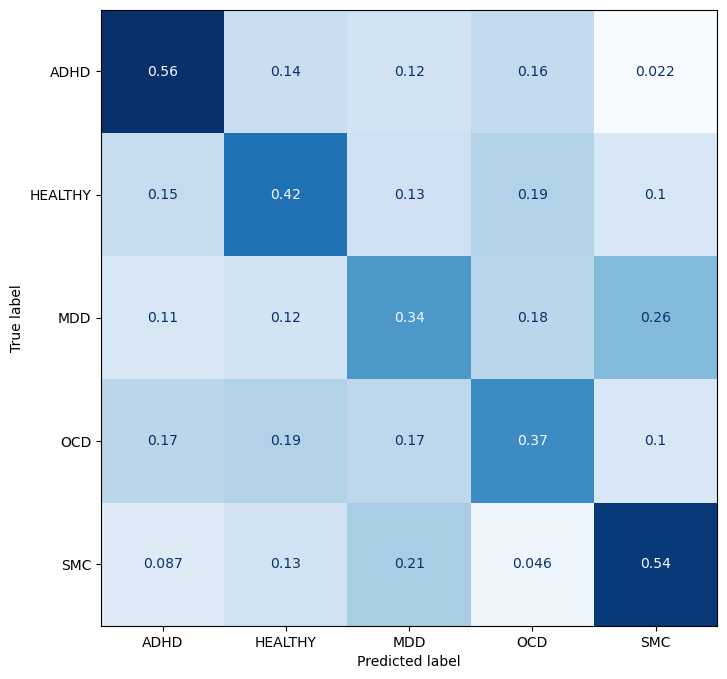

In [94]:
# print the confusion matrix normalized by true labels
fig, ax = plt.subplots(figsize=(8,8))
conf_matrix = confusion_matrix(Y, Y_pred, normalize='true')
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', colorbar=False, ax=ax)

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 319), X_test.shape = (672, 319), Y_train.shape = (2028,), Y_test.shape = (672,)


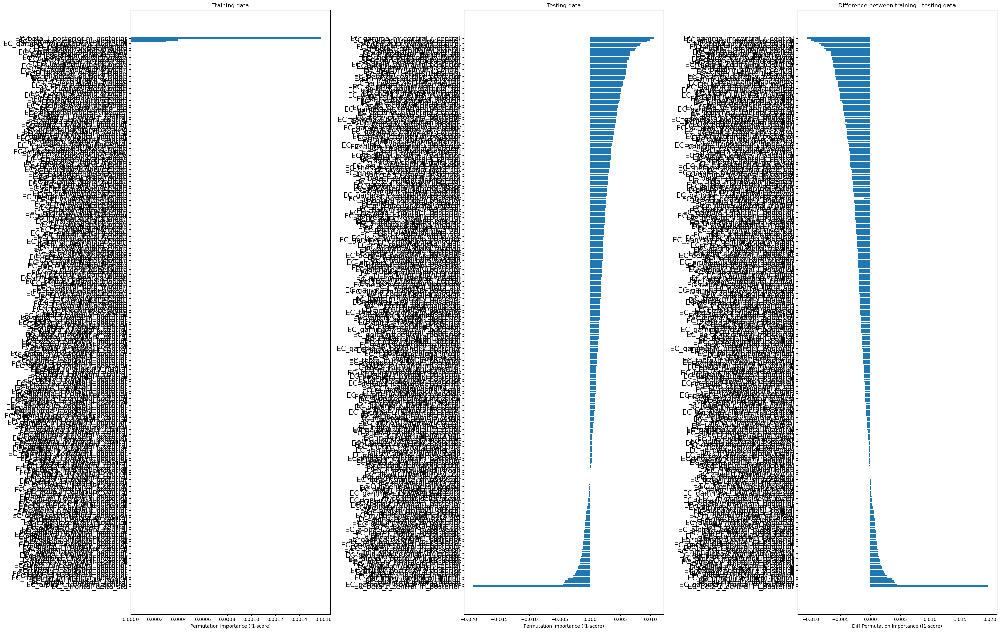

In [95]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')
ax1.tick_params(axis='y', labelsize=15)  # Adjust font size

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')
ax2.tick_params(axis='y', labelsize=15)  # Adjust font size

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')
ax3.tick_params(axis='y', labelsize=15)  # Adjust font size

plt.subplots_adjust(wspace=0.5)  # Increase the width space between subplots
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the layout to fit everything nicely
plt.show()

#### EO feature set

In [96]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import GradientBoostingClassifier
from scipy.stats import loguniform


# assign groups (IDs) for GroupKFold
groups = df_stat_conn_features_eo['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_conn_features_eo.columns if 'EO' in num_col]
 
X = df_stat_conn_features_eo[numeric_cols]
Y = df_stat_conn_features_eo['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)


# final pipeline
steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of boosting stages to perform
n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1000, num = 10)]
# Loss function to be optimized
loss = ['log_loss']
# Learning rate
learning_rate = loguniform.rvs(0.001, 0.1, size=1000)
# Fraction of samples to be used for fitting the individual base learners
subsample = [x for x in np.linspace(0.5, 1, 5)]
# The function to measure the quality of the split
criterion = ['friedman_mse']
# The min number of samples required to split an internal node
min_samples_split = [2, 5, 10]
# Create the random grid
random_grid = {'gbc__n_estimators': n_estimators,
               'gbc__loss': loss,
               'gbc__learning_rate': learning_rate,
               'gbc__subsample': subsample,
               'gbc__criterion': criterion,
               'gbc__min_samples_split': min_samples_split}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# nested CV with parameter optimization to compute testing score (f1-score)
nested_cv_randsearch = cross_validate(randsearch,
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 return_estimator=True,
                                 return_train_score = False,
                                 verbose=1,
                                 n_jobs=-1)
print('GBC test scores:', nested_cv_randsearch['test_score'])
print('Mean GBC test score:', np.mean(nested_cv_randsearch['test_score']))
print('STD GBC test score:', np.std(nested_cv_randsearch['test_score']))

# obtain best model during nested CV
best_score_index = np.argmax(nested_cv_randsearch['test_score'])
best_model = nested_cv_randsearch['estimator'][best_score_index]
print('Parameters of the best model:', best_model.best_params_)

# of instances: 2700
(2700, 5)


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
GBC test scores: [0.45840123 0.42512309 0.35836013 0.33139943 0.44299906]
Mean GBC test score: 0.4032565873982207
STD GBC test score: 0.049553370248696126
Parameters of the best model: {'gbc__subsample': 0.5, 'gbc__n_estimators': 900, 'gbc__min_samples_split': 10, 'gbc__loss': 'log_loss', 'gbc__learning_rate': 0.0756037588366562, 'gbc__criterion': 'friedman_mse'}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 270.3min finished


In [97]:
# save the nested CV
joblib.dump(nested_cv_randsearch, 'nested_cv_statconn_gbc_eo.pkl', compress=3)

['nested_cv_statconn_gbc_eo.pkl']

{'subsample': 0.5, 'n_estimators': 900, 'min_samples_split': 10, 'loss': 'log_loss', 'learning_rate': 0.0756037588366562, 'criterion': 'friedman_mse'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  8.0min finished


f1_score: 0.41201036462031215

classification report:
               precision    recall  f1-score   support

        ADHD       0.46      0.47      0.47       540
     HEALTHY       0.34      0.34      0.34       540
         MDD       0.27      0.28      0.28       540
         OCD       0.43      0.41      0.42       540
         SMC       0.56      0.55      0.56       540

    accuracy                           0.41      2700
   macro avg       0.41      0.41      0.41      2700
weighted avg       0.41      0.41      0.41      2700



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  8.0min finished


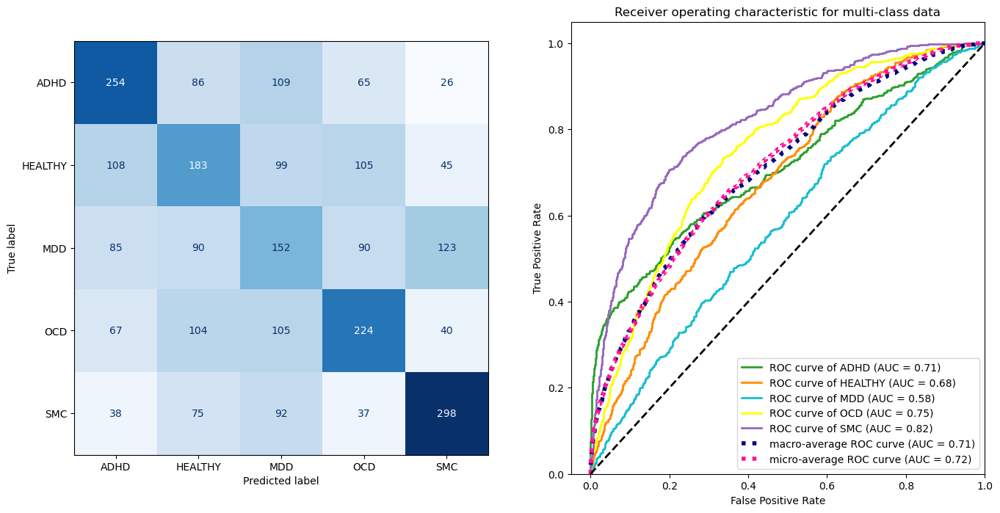

In [98]:
# final pipeline
best_params = {}
for hyperparameter in best_model.best_params_:
    key = hyperparameter[5:]
    best_params[key] = best_model.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

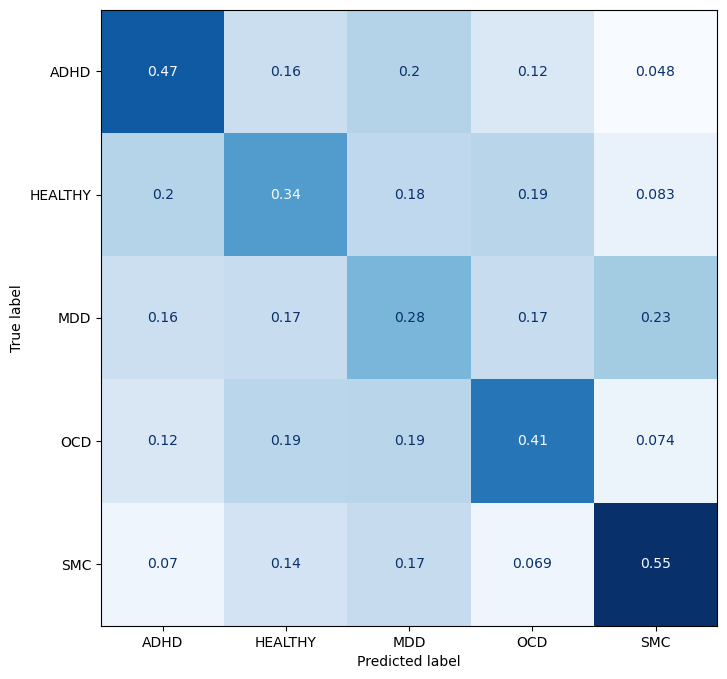

In [99]:
# print the confusion matrix normalized by true labels
fig, ax = plt.subplots(figsize=(8,8))
conf_matrix = confusion_matrix(Y, Y_pred, normalize='true')
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', colorbar=False, ax=ax)

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 301), X_test.shape = (672, 301), Y_train.shape = (2028,), Y_test.shape = (672,)


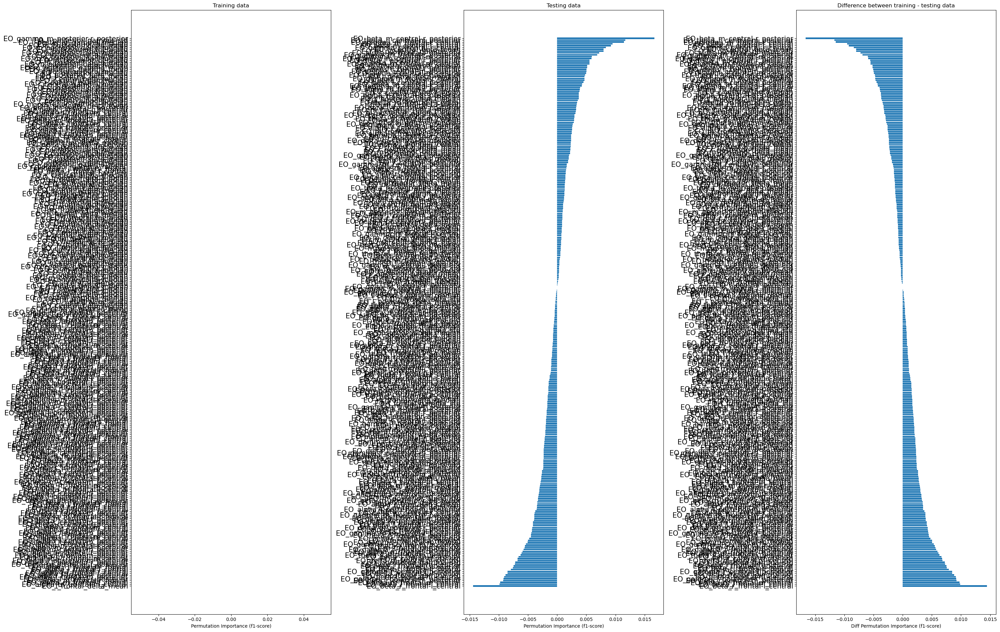

In [100]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')
ax1.tick_params(axis='y', labelsize=15)  # Adjust font size

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')
ax2.tick_params(axis='y', labelsize=15)  # Adjust font size

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')
ax3.tick_params(axis='y', labelsize=15)  # Adjust font size

plt.subplots_adjust(wspace=0.5)  # Increase the width space between subplots
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the layout to fit everything nicely
plt.show()